<a href="https://colab.research.google.com/github/sujitkumar205/Cognition/blob/fixed-nodes/Cognition_Analysis.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Required

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from scipy.stats import chi2_contingency
from scipy.stats import spearmanr
import math
import os
from PIL import Image

In [ ]:
radius = 40
IPAD_WIDTH = 820
IPAD_HEIGHT = 1180

In [ ]:
df = pd.read_csv('test_data.csv')
df = df.dropna()
df = df.sort_values('id')

In [ ]:
#df = df[df['pid'].isin([6, 8])]

In [ ]:
df.head()

,id,pid,blockno,coordx,coordy,coordt,realpointid,realpointx,realpointy,fakepointid,fakepointx,fakepointy,speed,pausevalue,correctangle,wrongangle,err,errorcorrected
0,30772,6,1,422,974,2,checkpointA,31.046875,287.890625,checkpoint2Fake,491.8125,115.546875,0.000000,0,0.000000,0.000000,0,0
1,30773,6,1,421,967,1075,checkpointA,31.046875,287.890625,checkpoint2Fake,491.8125,115.546875,0.006590,1073,20.379783,15.771885,1,0
2,30774,6,1,420,967,1341,checkpointA,31.046875,287.890625,checkpoint2Fake,491.8125,115.546875,0.003759,266,61.296485,97.776243,0,1
3,30775,6,1,419,967,2057,checkpointA,31.046875,287.890625,checkpoint2Fake,491.8125,115.546875,0.001397,716,61.365501,97.845548,0,0
4,30776,6,1,419,966,2074,checkpointA,31.046875,287.890625,checkpoint2Fake,491.8125,115.546875,0.058824,17,28.565393,7.914829,1,0


In [ ]:
participantID = df['pid'].unique()
print(participantID)

[ 6  8 26 27]


In [ ]:
def images_to_pdf(image_folder, output_pdf_path):
    # List all PNG files in the specified directory
    image_files = [f for f in os.listdir(image_folder) if f.endswith('.png')]

    # Sort files to maintain order (optional)
    image_files.sort()

    # Load images and convert to RGB mode if necessary
    images = []
    for file_name in image_files:
        file_path = os.path.join(image_folder, file_name)
        img = Image.open(file_path)
        if img.mode != 'RGB':
            img = img.convert('RGB')
        images.append(img)

    # Save the images as a PDF
    if images:
        images[0].save(output_pdf_path, save_all=True, append_images=images[1:])

In [ ]:
# Function to divide time and speed based on -1 in time
def divide_segments(time, speed):
    segments = []
    temp_time = []
    temp_speed = []

    for t, s in zip(time, speed):
        if t == -1 or t == -2:
            if temp_time and temp_speed:
                segments.append((temp_time, temp_speed))  # Add the current segment
            temp_time = []  # Reset for new segment
            temp_speed = []
        else:
            temp_time.append(t)
            temp_speed.append(s)

    # Add the last segment if it exists
    if temp_time and temp_speed:
        segments.append((temp_time, temp_speed))

    return segments

In [ ]:
def calculate_speeds(coordx, coordy, time):
    # Convert lists to numpy arrays for easier calculations
    coordx = np.array(coordx)
    coordy = np.array(coordy)
    time = np.array(time)

    # Calculate differences between successive points
    dx = np.diff(coordx)
    dy = np.diff(coordy)
    dt = np.diff(time)

    # Calculate speed components
    speed_x = abs(dx / dt)
    speed_y = abs(dy / dt)

    return speed_x, speed_y

In [ ]:
# Function to divide time and speed based on -1 in time
def confidence_split(time, speed, err):
    segments = []
    temp_time_1 = []
    temp_speed_1 = []
    temp_time_2 = []
    temp_speed_2 = []

    for t, s, e in zip(time, speed, err):
        if e == 1:
            temp_time_1.append(t)
            temp_speed_1.append(s)
        else:
            temp_time_2.append(t)
            temp_speed_2.append(s)

    # Add the last segment if it exists

    segments.append((temp_time_1, temp_speed_1))
    segments.append((temp_time_2, temp_speed_2))

    return segments

In [ ]:
def max_min_speed_time(time, speed):
  max_speed_index = speed.index(max(speed))
  min_speed_index = speed.index(min(speed))

  max_speed_time = time[max_speed_index]
  min_speed_time = time[min_speed_index]
  return [max(speed), max_speed_time, min(speed), min_speed_time]

In [ ]:
mean_df = pd.DataFrame(columns=['pid','blockno','numpause', 'maxpause','minpause', 'avgpause','error_rate','numerrorcorr', 'maxspeed', 'minspeed', 'avgspeed','moca'])
for i in participantID:
  if i == -1:
    continue
  else:
    pid_df = df.loc[df['pid'] == i]
    blockno = pid_df['blockno'].unique()
    for j in blockno:
      block_df = pid_df.loc[pid_df['blockno'] == j]

      num_pauses = block_df[block_df.pausevalue >= 100].shape[0]
      maxpause = block_df[block_df.pausevalue >= 100]['pausevalue'].max()
      minpause = block_df[block_df.pausevalue >= 100]['pausevalue'].min()
      avgpause = block_df[block_df.pausevalue >= 100].loc[:, 'pausevalue'].mean()

      num_error = block_df[block_df.err == 1].shape[0]
      error_rate = num_error / block_df.shape[0]
      num_errorcorr = block_df[block_df.errorcorrected == 1].shape[0]

      maxspeed = block_df['speed'].max()
      minspeed = block_df[block_df.speed > 0]['speed'].min()
      avgspeed = block_df.loc[:, 'speed'].mean()

      moca = np.random.randint(26, 31)
      #df['moca'] = np.random.randint(26, 31, df.shape[0])

      mean_measures = [i, j, num_pauses, maxpause, minpause, avgpause, error_rate, num_errorcorr, maxspeed, minspeed, avgspeed, moca]

      mean_df.loc[len(mean_df)] = mean_measures

# Scatter and Correlation

In [ ]:
def scatter_plot(xaxis, yaxis, title, x_label, y_label):
  plt.title(title)
  plt.xlabel(x_label)
  plt.ylabel(y_label)
  plt.scatter(xaxis, yaxis)
  plt.show()

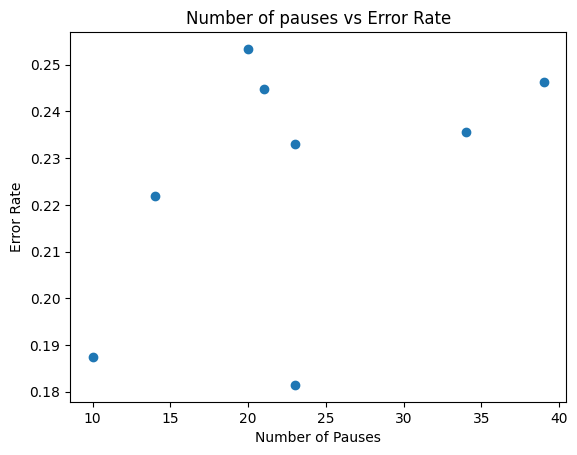

In [ ]:
scatter_plot(mean_df['numpause'], mean_df['error_rate'], "Number of pauses vs Error Rate", "Number of Pauses", "Error Rate")

In [ ]:
def perform_chi_square_test(data, col1, col2):
    # Creating a contingency table
    contingency_table = pd.crosstab(data[col1], data[col2])

    # Performing the Chi-Square Test
    chi2, p, dof, expected = chi2_contingency(contingency_table)

    # Interpreting the result
    significant = p < 0.05  # 5% significance level
    return chi2, p, significant

In [ ]:
def perform_spearman_correlation(data, col1, col2):
    # Calculating Spearman Correlation
    correlation, p_value = spearmanr(data[col1], data[col2])

    # Interpreting the result
    significant = p_value < 0.05  # 5% significance level
    return correlation, p_value, significant

In [ ]:
mean_columns=['pid','blockno','numpause', 'maxpause','minpause', 'avgpause','error_rate','numerrorcorr', 'maxspeed', 'minspeed', 'avgspeed','moca']
for i in range(0, len(mean_columns)-1):
  for j in range(i+1, len(mean_columns)):
    '''
    chi = perform_chi_square_test(mean_df, mean_columns[i], mean_columns[j])
    if(not chi[2]):
      print("columns: ", mean_columns[i], " and ", mean_columns[j])
      print("chi2 value: ", chi[0])
      print("p value: ", chi[1])
      print("Correlation: ", chi[2])
      print()
    '''

    spear = perform_spearman_correlation(mean_df, mean_columns[i], mean_columns[j])
    if(spear[2]):
      print("columns: ", mean_columns[i], " and ", mean_columns[j])
      print("correlation value: ", spear[0])
      print("p value: ", spear[1])
      print("significance: ", spear[2])
      print()

<ipython-input-16-e2c80d7fba41>:3: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  correlation, p_value = spearmanr(data[col1], data[col2])


columns:  blockno  and  avgpause
correlation value:  -0.7857142857142858
p value:  0.020815127253525276
significance:  True

columns:  numpause  and  maxpause
correlation value:  0.8862434338158116
p value:  0.003373342932352387
significance:  True

columns:  numpause  and  minspeed
correlation value:  -0.7650602409638554
p value:  0.026975647289092654
significance:  True

columns:  maxpause  and  minspeed
correlation value:  -0.8982196964349441
p value:  0.002438796796382353
significance:  True

columns:  avgpause  and  minspeed
correlation value:  -0.8383383833392813
p value:  0.009323115735056045
significance:  True

columns:  error_rate  and  numerrorcorr
correlation value:  0.8095238095238096
p value:  0.014902667686230067
significance:  True



#Trajectory with error marks and speed on right



In [ ]:
def plot_combined(coordx, coordy, speed, err, real, fake, prev_origin, pid, blockno, trialname):
    # Create the figure and two subplots side by side
    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(16, 8))

    # Plot Trajectory with Errors on the first subplot
    # Separate points based on error value
    x_normal = [x for x, e in zip(coordx, err) if e == 0]
    y_normal = [y for y, e in zip(coordy, err) if e == 0]

    x_error_temp = [x for x, e in zip(coordx, err) if e == 1]
    y_error_temp = [y for y, e in zip(coordy, err) if e == 1]

    x_error = []
    y_error = []

    for i in range(len(x_error_temp)):
        if math.dist([x_error_temp[i], y_error_temp[i]], prev_origin) > radius:
            x_error.append(x_error_temp[i])
            y_error.append(y_error_temp[i])
        else:
            x_normal.append(x_error_temp[i])
            y_normal.append(y_error_temp[i])

    ax1.plot(x_normal, y_normal, marker='.', linestyle='', color='green', label='Normal')
    ax1.plot(x_error, y_error, marker='.', linestyle='', color='red', label='Error')

    ax1.scatter(real[0], real[1], color='green', s=3000, edgecolor='black', label='Target', zorder=5)  # Target
    ax1.scatter(fake[0], fake[1], color='red', s=3000, edgecolor='black', label='Fake', zorder=5)  # Fake
    ax1.scatter(coordx.iloc[0], coordy.iloc[0], color='yellow', s=3000, edgecolor='black', label='Start', zorder=4)

    ax1.set_xlabel('X Coordinate')
    ax1.set_ylabel('Y Coordinate')
    ax1.set_title(f'Error Plot for Participant {pid}, Block {blockno} for Target {trialname}')
    ax1.legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderpad=2, labelspacing = 5)
    ax1.grid(True)

    # Set grid limits for the first subplot
    l1 = np.arange(0, IPAD_WIDTH + 100, 100)
    ax1.set_xticks(l1)
    l2 = np.arange(0, IPAD_HEIGHT + 100, 100)
    ax1.set_yticks(l2)
    ax1.set_xlim(0, IPAD_WIDTH)
    ax1.set_ylim(0, IPAD_HEIGHT)

    # Plot Trajectory with Speed on the second subplot
    hot_reversed = plt.cm.get_cmap('hot_r')

    sc = ax2.scatter(coordx, coordy, c=speed, cmap = hot_reversed, s=10, label='Trajectory', zorder=2)
    cbar = plt.colorbar(sc, ax=ax2)
    cbar.set_label('Speed')

    ax2.scatter(real[0], real[1], color='green', s=3000, edgecolor='black', label='Target', zorder=5)  # Target
    ax2.scatter(fake[0], fake[1], color='red', s=3000, edgecolor='black', label='Fake', zorder=5)  # Fake
    ax2.scatter(coordx.iloc[0], coordy.iloc[0], color='yellow', s=3000, edgecolor='black', label='Start', zorder=4)

    ax2.set_xlabel('X Coordinate')
    ax2.set_ylabel('Y Coordinate')
    ax2.set_title(f'Speed Plot for Participant {pid}, Block {blockno} for Target {trialname}')
    #ax2.legend(loc='upper left')
    ax2.grid(True)

    # Set grid limits for the second subplot
    ax2.set_xticks(l1)
    ax2.set_yticks(l2)
    ax2.set_xlim(0, IPAD_WIDTH)
    ax2.set_ylim(0, IPAD_HEIGHT)

    # Adjust layout
    plt.tight_layout()

    filename = f'{pid}_{blockno}_{trialname}.png'
    filepath = os.path.join("/content/error_speed", filename)
    plt.savefig(filepath)

    plt.show()

<ipython-input-18-055156e966b2>:46: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  hot_reversed = plt.cm.get_cmap('hot_r')


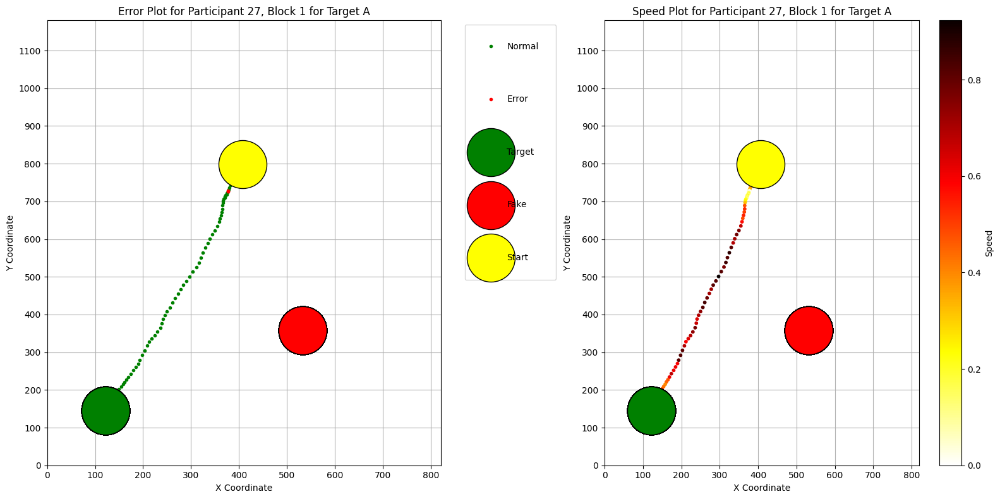

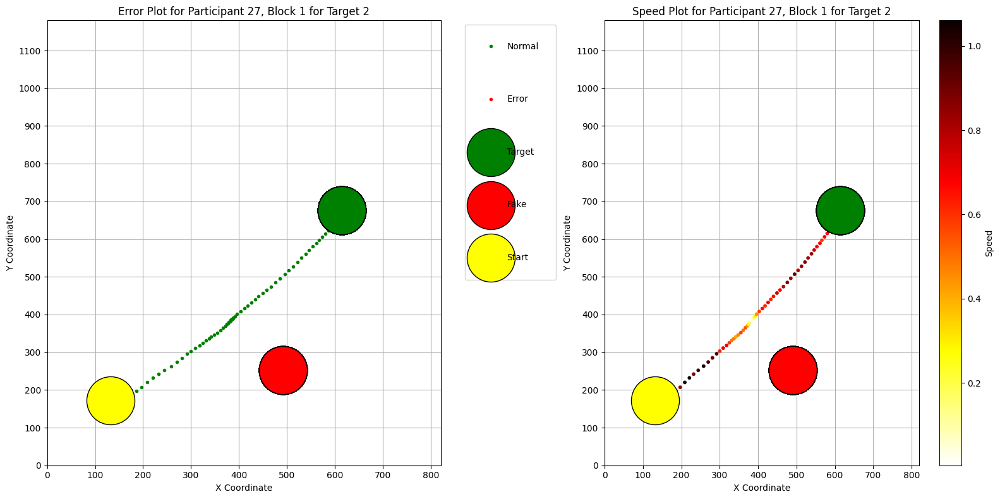

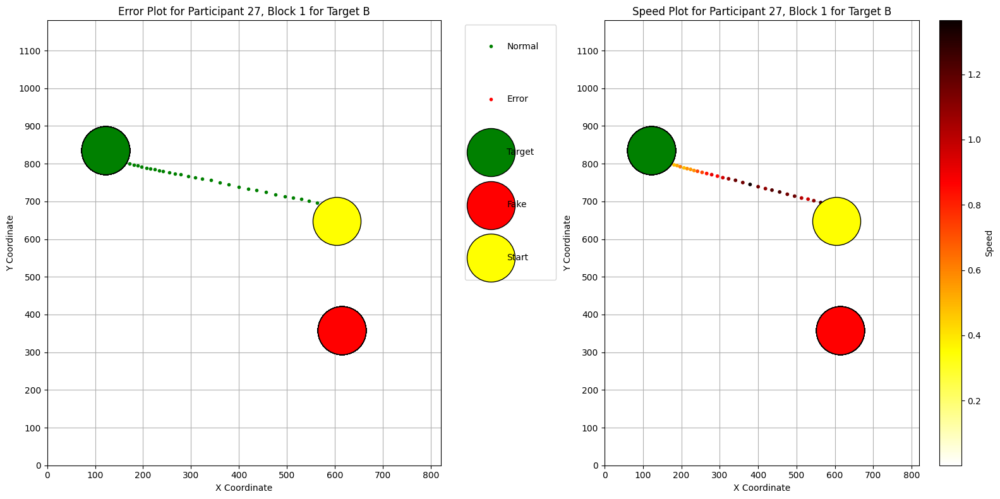

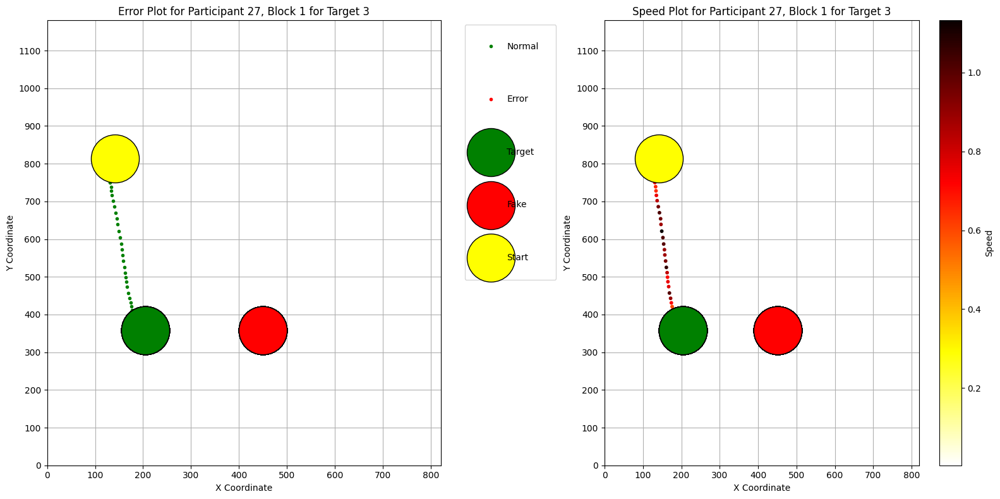

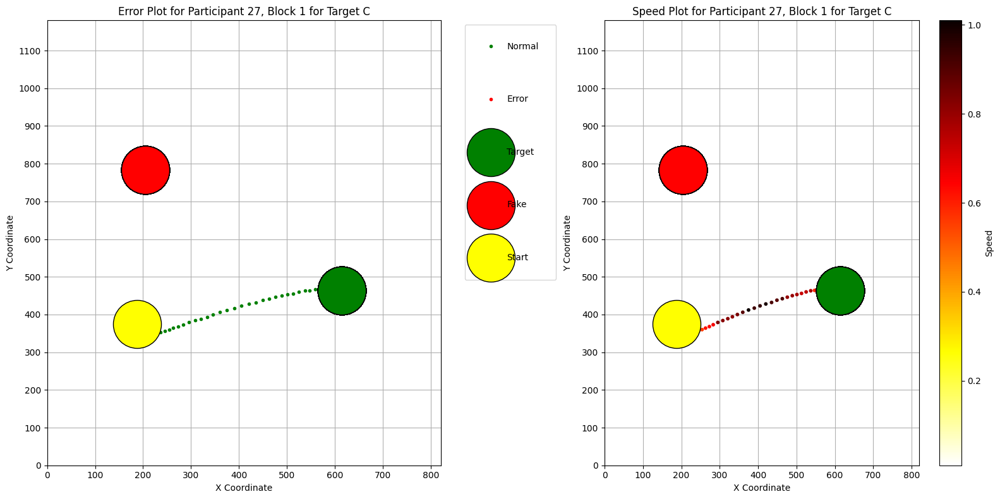

...

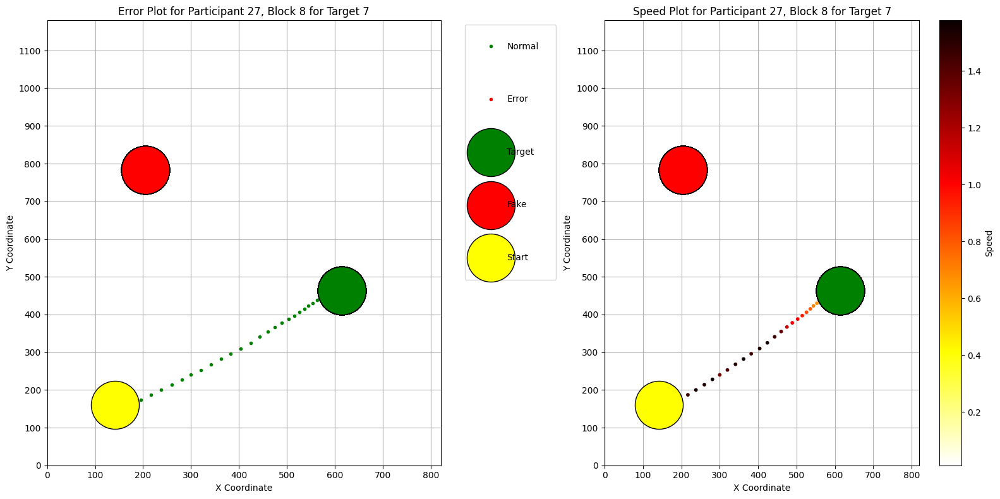

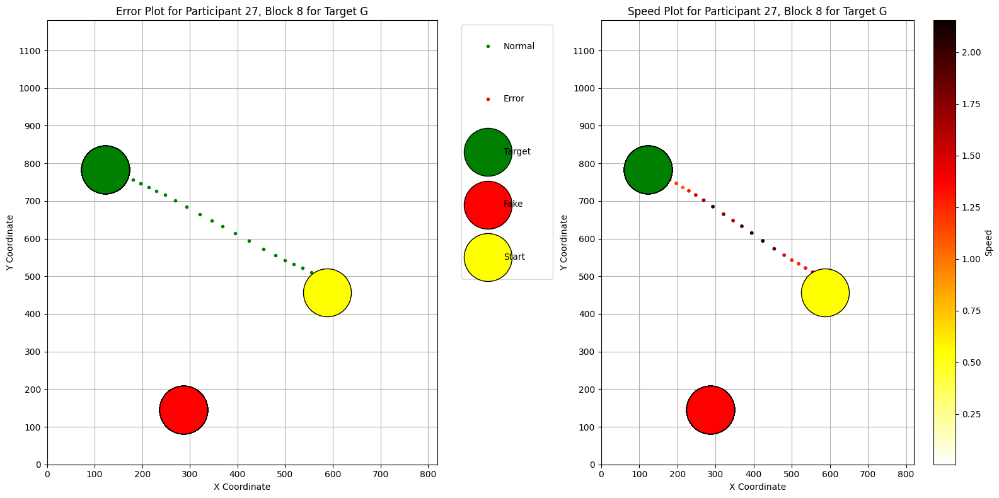

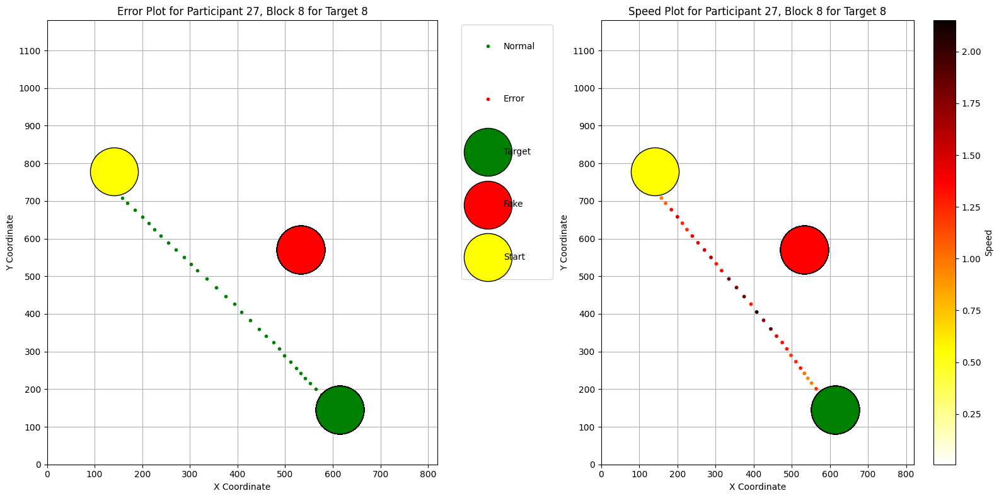

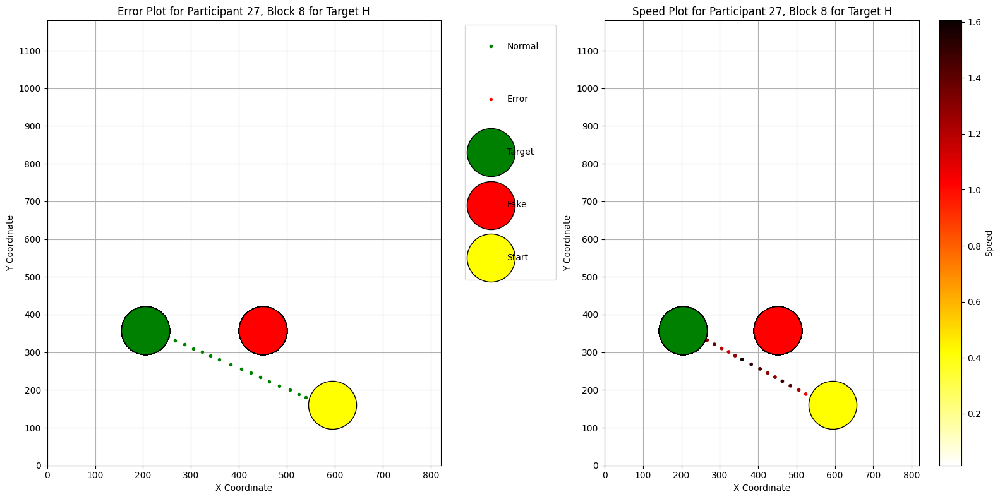

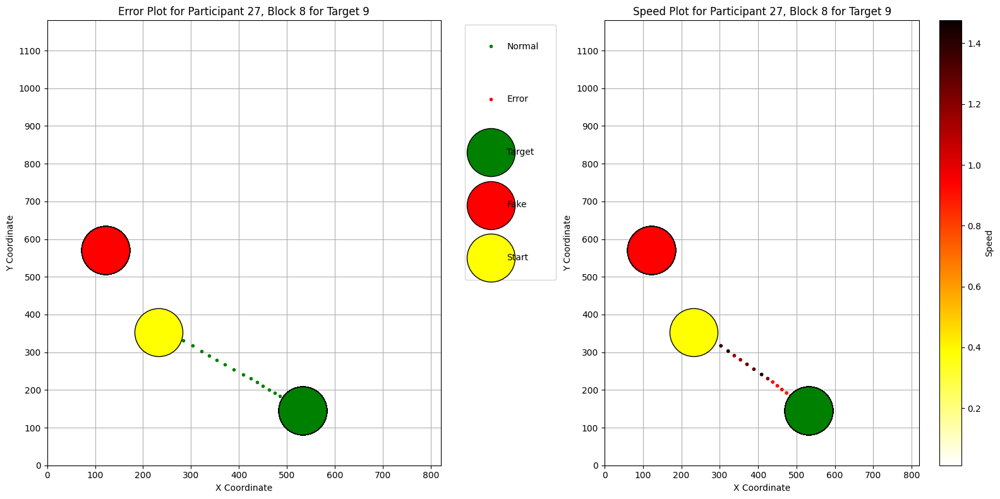

In [ ]:
if not os.path.exists('/content/error_speed'):
    os.makedirs('/content/error_speed')

for file_name in os.listdir('/content/error_speed'):
    file_path = os.path.join('/content/error_speed', file_name)
    if os.path.isfile(file_path):
        os.remove(file_path)

for i in df['pid'].unique():
    for j in df['blockno'].unique():
        prev_real = []
        for k in df['realpointid'].unique():
            df_trial = df.loc[(df['pid'] == i) & (df['blockno'] == j) & (df['realpointid'] == k)]

            prev_real = [df_trial['realpointx'].iloc[0] + radius, df_trial['realpointy'].iloc[0] + radius]

            # Include speed and error as part of the call
            plot_combined(df_trial['coordx'], df_trial['coordy'], df_trial['speed'],
                          df_trial['err'], [df_trial['realpointx'] + radius, df_trial['realpointy'] + radius],
                          [df_trial['fakepointx'] + radius, df_trial['fakepointy'] + radius],
                          prev_real, i, j, df_trial['realpointid'].iloc[0])

image_folder = '/content/error_speed'
output_pdf_path = '/content/combined_plots.pdf'

images_to_pdf(image_folder, output_pdf_path)

#Trajectory with error marks and pauses on right

In [ ]:
def plot_combined_pause(coordx, coordy, pause, err, real, fake, prev_origin, pid, blockno, trialname):
    # Create the figure and two subplots side by side
    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(16, 8))

    # Plot Trajectory with Errors on the first subplot
    # Separate points based on error value
    x_normal = [x for x, e in zip(coordx, err) if e == 0]
    y_normal = [y for y, e in zip(coordy, err) if e == 0]

    x_error_temp = [x for x, e in zip(coordx, err) if e == 1]
    y_error_temp = [y for y, e in zip(coordy, err) if e == 1]

    x_error = []
    y_error = []

    for i in range(len(x_error_temp)):
        if math.dist([x_error_temp[i], y_error_temp[i]], prev_origin) > radius:
            x_error.append(x_error_temp[i])
            y_error.append(y_error_temp[i])
        else:
            x_normal.append(x_error_temp[i])
            y_normal.append(y_error_temp[i])

    ax1.plot(x_normal, y_normal, marker='.', linestyle='', color='green', label='Normal')
    ax1.plot(x_error, y_error, marker='.', linestyle='', color='red', label='Error')

    ax1.scatter(real[0], real[1], color='green', s=3000, edgecolor='black', label='Target', zorder=5)  # Target
    ax1.scatter(fake[0], fake[1], color='red', s=3000, edgecolor='black', label='Fake', zorder=5)  # Fake
    ax1.scatter(coordx.iloc[0], coordy.iloc[0], color='yellow', s=3000, edgecolor='black', label='Start', zorder=4)

    ax1.set_xlabel('X Coordinate')
    ax1.set_ylabel('Y Coordinate')
    ax1.set_title(f'Error Plot for Participant {pid}, Block {blockno} for Target {trialname}')
    ax1.legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderpad=2, labelspacing = 5)
    ax1.grid(True)

    # Set grid limits for the first subplot
    l1 = np.arange(0, IPAD_WIDTH + 100, 100)
    ax1.set_xticks(l1)
    l2 = np.arange(0, IPAD_HEIGHT + 100, 100)
    ax1.set_yticks(l2)
    ax1.set_xlim(0, IPAD_WIDTH)
    ax1.set_ylim(0, IPAD_HEIGHT)

    # Plot Trajectory with Speed on the second subplot
    #hot_reversed = plt.cm.get_cmap('hot_r')

    x_normal = [x for x, e in zip(coordx, pause) if e < 100]
    y_normal = [y for y, e in zip(coordy, pause) if e < 100]

    x_pause = [x for x, e in zip(coordx, pause) if e >= 100]
    y_pause = [y for y, e in zip(coordy, pause) if e >= 100]

    ax2.plot(x_normal, y_normal, marker='.', linestyle='', color='blue', label='Normal', zorder=1)
    ax2.plot(x_pause, y_pause, marker='o', linestyle='', color='red', label='Pause', zorder=1)

    #sc = ax2.scatter(coordx, coordy, c=pause, cmap = 'coolwarm', s=10, label='Trajectory', zorder=2)
    #cbar = plt.colorbar(sc, ax=ax2)
    #cbar.set_label('Pause')

    ax2.scatter(real[0], real[1], color='green', s=3000, edgecolor='black', label='Target', zorder=2)  # Target
    ax2.scatter(fake[0], fake[1], color='red', s=3000, edgecolor='black', label='Fake', zorder=2)  # Fake
    ax2.scatter(coordx.iloc[0], coordy.iloc[0], color='yellow', s=3000, edgecolor='black', label='Start', zorder=2)

    ax2.set_xlabel('X Coordinate')
    ax2.set_ylabel('Y Coordinate')
    ax2.set_title(f'Pause Plot for Participant {pid}, Block {blockno} for Target {trialname}')
    #ax2.legend(loc='upper left')
    ax2.grid(True)

    # Set grid limits for the second subplot
    ax2.set_xticks(l1)
    ax2.set_yticks(l2)
    ax2.set_xlim(0, IPAD_WIDTH)
    ax2.set_ylim(0, IPAD_HEIGHT)

    # Adjust layout
    plt.tight_layout()

    filename = f'{pid}_{blockno}_{trialname}.png'
    filepath = os.path.join("/content/error_pause", filename)
    plt.savefig(filepath)

    plt.show()

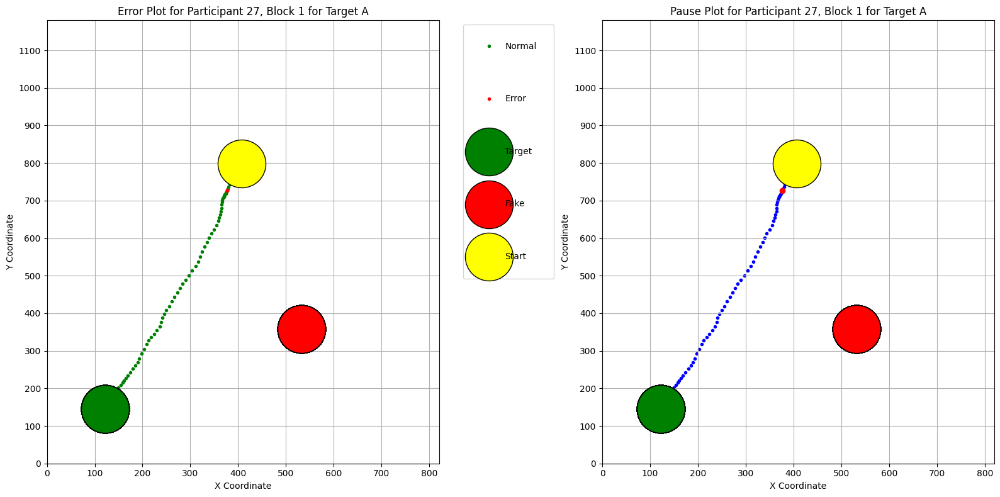

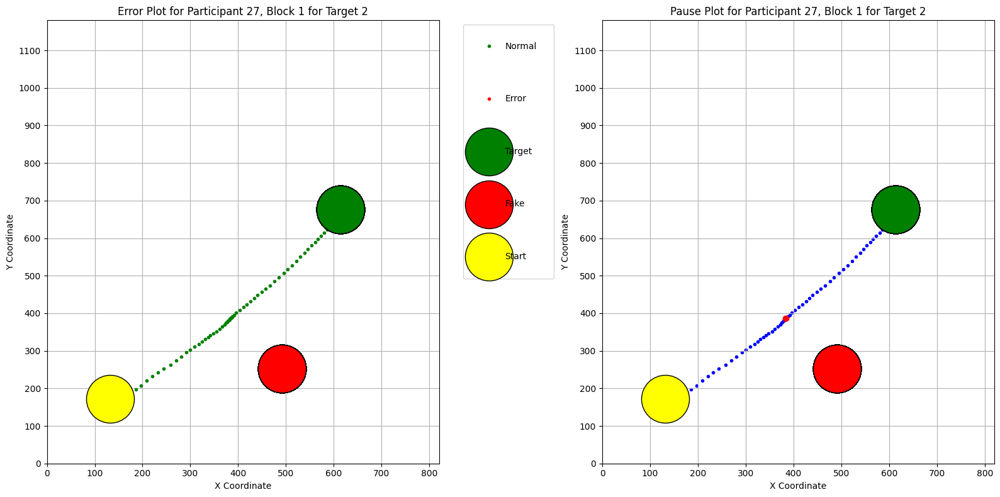

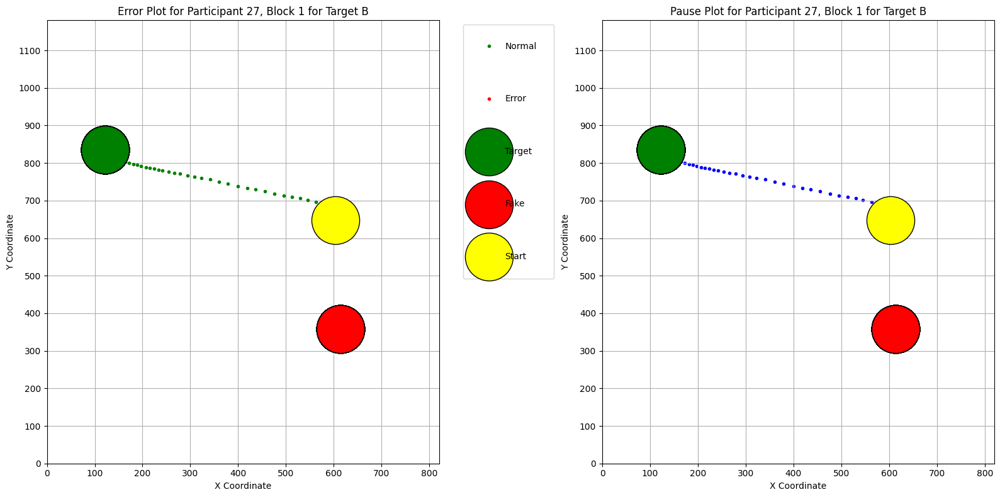

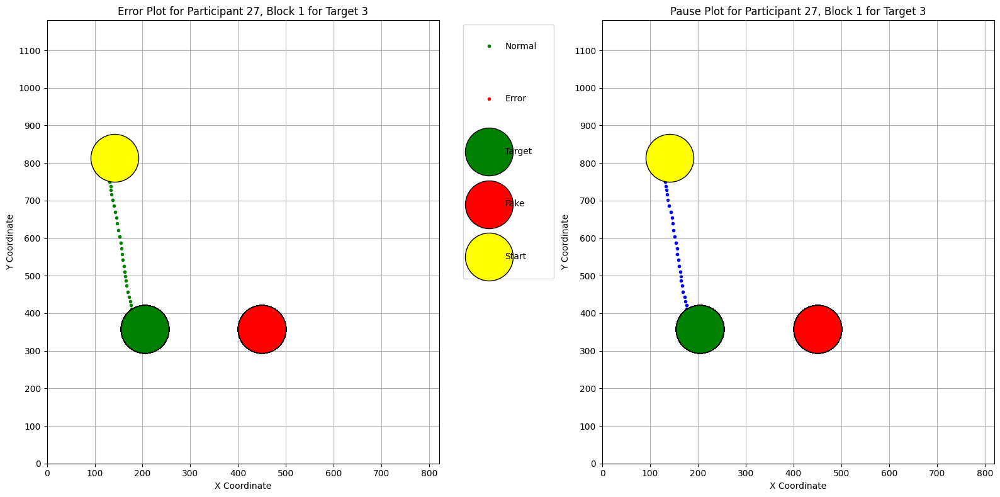

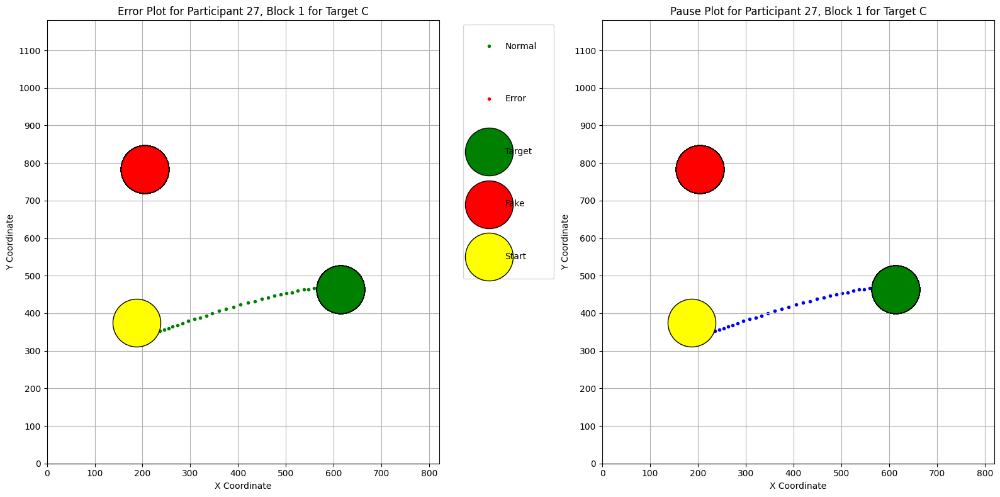

...

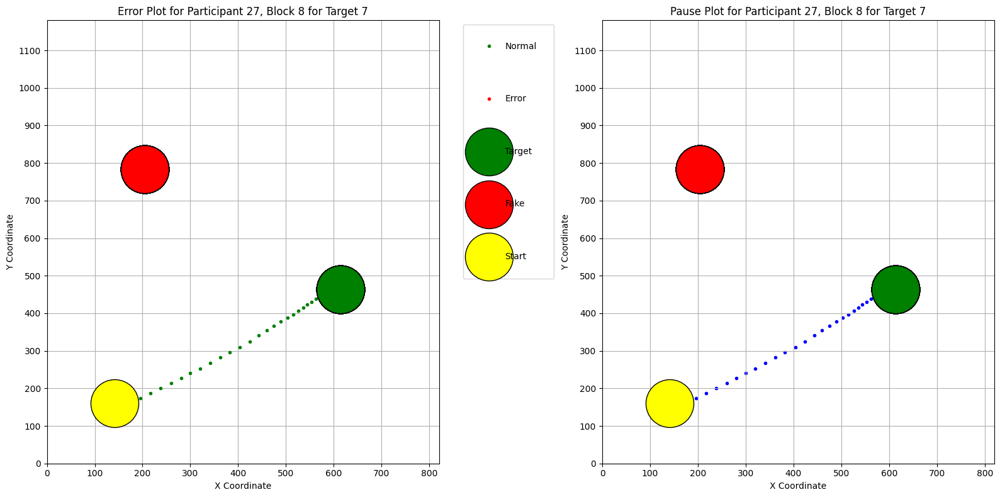

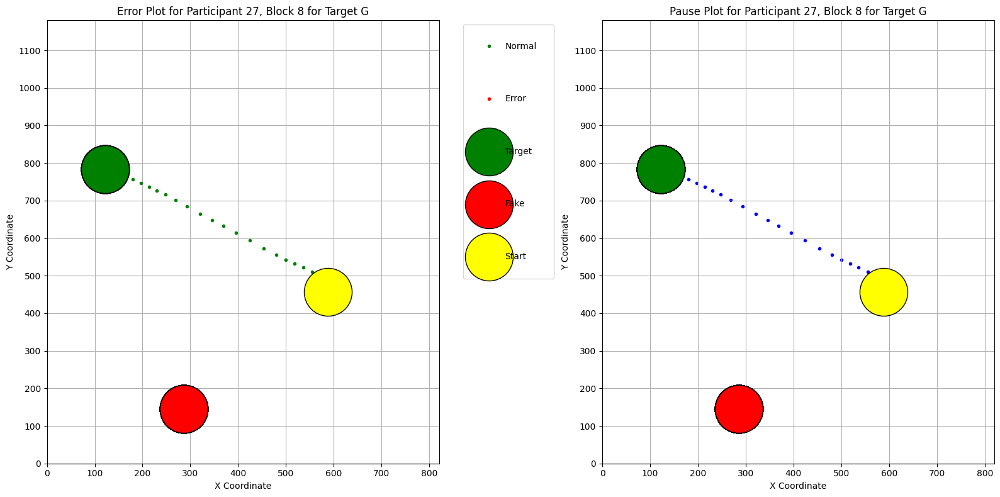

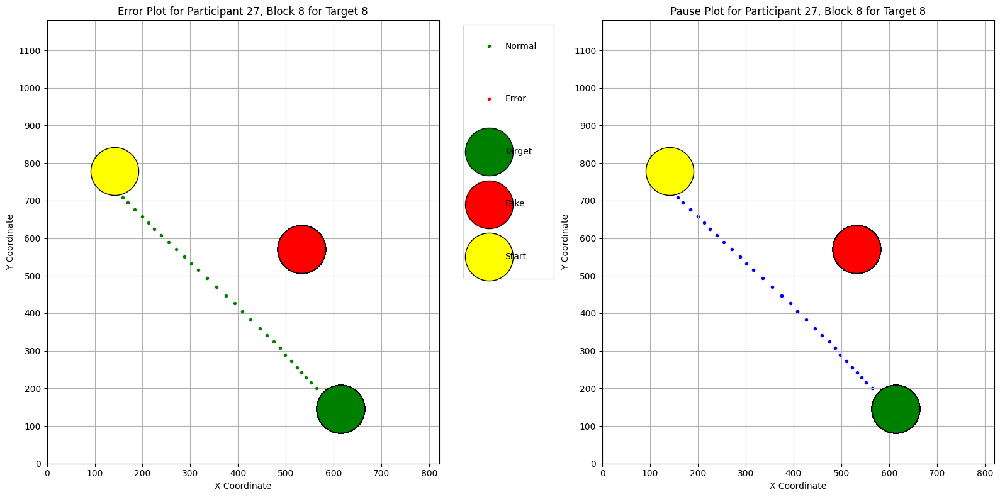

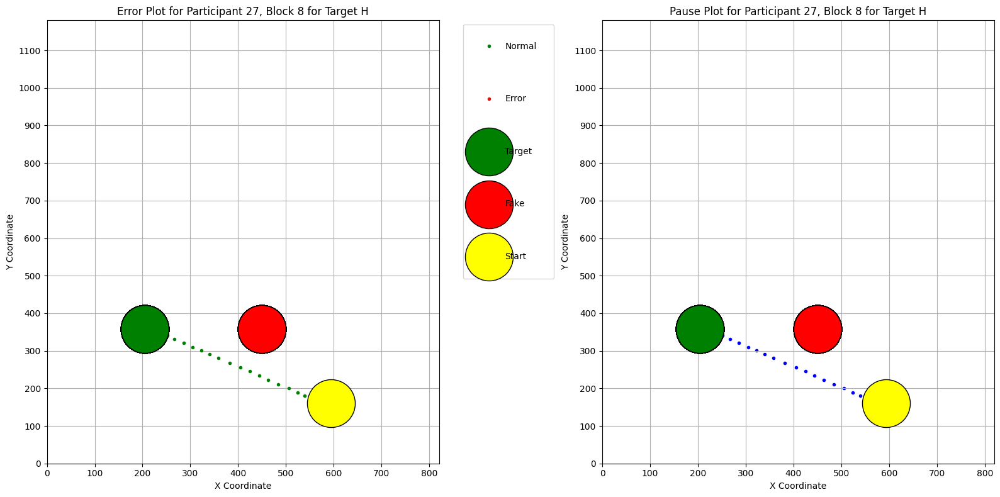

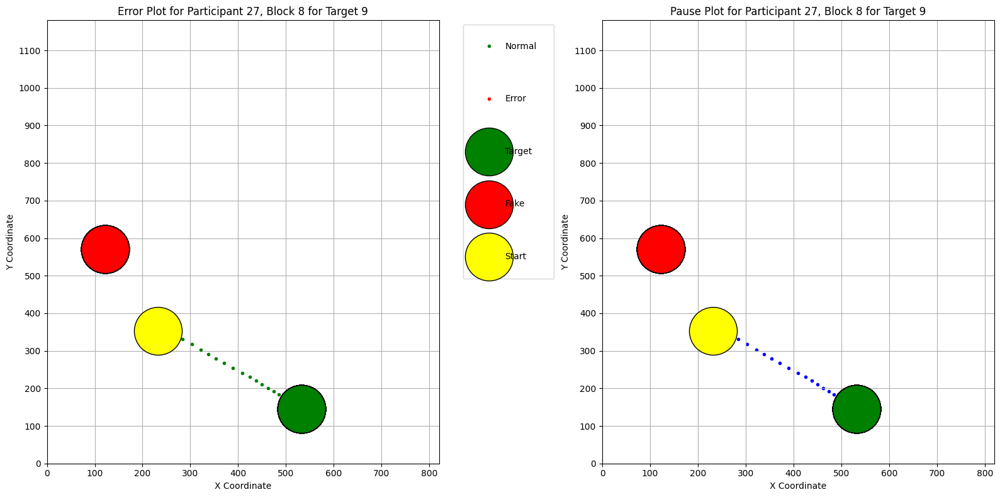

In [ ]:
if not os.path.exists('/content/error_pause'):
    os.makedirs('/content/error_pause')

for file_name in os.listdir('/content/error_pause'):
    file_path = os.path.join('/content/error_pause', file_name)
    if os.path.isfile(file_path):
        os.remove(file_path)

for i in df['pid'].unique():
    for j in df['blockno'].unique():
        prev_real = []
        for k in df['realpointid'].unique():
            df_trial = df.loc[(df['pid'] == i) & (df['blockno'] == j) & (df['realpointid'] == k)]

            prev_real = [df_trial['realpointx'].iloc[0] + radius, df_trial['realpointy'].iloc[0] + radius]

            # Include speed and error as part of the call
            plot_combined_pause(df_trial['coordx'], df_trial['coordy'], df_trial['pausevalue'],
                          df_trial['err'], [df_trial['realpointx'] + radius, df_trial['realpointy'] + radius],
                          [df_trial['fakepointx'] + radius, df_trial['fakepointy'] + radius],
                          prev_real, i, j, df_trial['realpointid'].iloc[0])

image_folder = '/content/error_pause'
output_pdf_path = '/content/combined_plots_pause.pdf'

images_to_pdf(image_folder, output_pdf_path)

#Trajectory with error marks and speed on right for TWO trials


In [ ]:
def plot_combined_trial_speed(coordx1, coordy1, pause1, err1, real1, fake1, prev_origin1, speed1,
                        coordx2, coordy2, pause2, err2, real2, fake2, prev_origin2, speed2,
                        pid, blockno, trialname1, trialname2):
    # Create the figure and two subplots side by side
    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(20, 10))

    # Plot Trajectory with Errors on the first subplot
    # Separate points based on error value
    x_normal = [x for x, e in zip(coordx1, err1) if e == 0]
    y_normal = [y for y, e in zip(coordy1, err1) if e == 0]

    x_error_temp = [x for x, e in zip(coordx1, err1) if e == 1]
    y_error_temp = [y for y, e in zip(coordy1, err1) if e == 1]

    x_error = []
    y_error = []

    for i in range(len(x_error_temp)):
        if math.dist([x_error_temp[i], y_error_temp[i]], prev_origin1) > radius:
            x_error.append(x_error_temp[i])
            y_error.append(y_error_temp[i])
        else:
            x_normal.append(x_error_temp[i])
            y_normal.append(y_error_temp[i])

    ax1.plot(x_normal, y_normal, marker='.', linestyle='', color='green', label='Normal')
    ax1.plot(x_error, y_error, marker='.', linestyle='', color='red', label='Error')

    ax1.scatter(real1[0], real1[1], color='green', s=3000, edgecolor='black', label='Target', zorder=5)  # Target
    ax1.scatter(fake1[0], fake1[1], color='red', s=3000, edgecolor='black', label='Fake', zorder=5)  # Fake
    ax1.scatter(coordx1.iloc[0], coordy1.iloc[0], color='yellow', s=3000, edgecolor='black', label='Start', zorder=4)


    # Plot Trajectory with Errors for the second trial
    x_normal2 = [x for x, e in zip(coordx2, err2) if e == 0]
    y_normal2 = [y for y, e in zip(coordy2, err2) if e == 0]

    x_error_temp2 = [x for x, e in zip(coordx2, err2) if e == 1]
    y_error_temp2 = [y for y, e in zip(coordy2, err2) if e == 1]

    x_error2 = []
    y_error2 = []

    for i in range(len(x_error_temp2)):
        if math.dist([x_error_temp2[i], y_error_temp2[i]], prev_origin2) > radius:
            x_error2.append(x_error_temp2[i])
            y_error2.append(y_error_temp2[i])
        else:
            x_normal2.append(x_error_temp2[i])
            y_normal2.append(y_error_temp2[i])

    ax1.plot(x_normal2, y_normal2, marker='.', linestyle='', color='green')
    ax1.plot(x_error2, y_error2, marker='.', linestyle='', color='red')

    ax1.scatter(real2[0], real2[1], color='blue', s=3000, edgecolor='black', label='Target 2', zorder=5)  # Target 2
    ax1.scatter(fake2[0], fake2[1], color='orange', s=3000, edgecolor='black', label='Fake 2', zorder=5)  # Fake 2

    ax1.set_xlabel('X Coordinate')
    ax1.set_ylabel('Y Coordinate')
    ax1.set_title(f'Trajectory and Errors for Participant {pid}, Block {blockno}\nTrials {trialname1} and {trialname2}')
    #ax1.legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderpad=2, labelspacing = 5)
    #ax1.legend(loc='center', bbox_to_anchor=(0.5, -0.1), ncol=7, borderpad=1, labelspacing=4)
    ax1.legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderpad=3, labelspacing=5)
    ax1.grid(True)

    # Set grid limits for the first subplot
    l1 = np.arange(0, IPAD_WIDTH + 100, 100)
    ax1.set_xticks(l1)
    l2 = np.arange(0, IPAD_HEIGHT + 100, 100)
    ax1.set_yticks(l2)
    ax1.set_xlim(0, IPAD_WIDTH)
    ax1.set_ylim(0, IPAD_HEIGHT)

    # Plot Trajectory with Speed on the second subplot
    hot_reversed = plt.cm.get_cmap('hot_r')

    sc = ax2.scatter(coordx1, coordy1, c=speed1, cmap = 'bwr', s=10, label='Trajectory', zorder=2)
    #cbar = plt.colorbar(sc, ax=ax2)
    #cbar.set_label('Speed')

    ax2.scatter(real1[0], real1[1], color='green', s=3000, edgecolor='black', label='Target', zorder=5)  # Target
    ax2.scatter(fake1[0], fake1[1], color='red', s=3000, edgecolor='black', label='Fake', zorder=5)  # Fake

    sc = ax2.scatter(coordx2, coordy2, c=speed2, cmap = 'bwr', s=10, label='Trajectory', zorder=2)
    #cbar = plt.colorbar(sc, ax=ax2)
    #cbar.set_label('Speed')

    ax2.scatter(real2[0], real2[1], color='blue', s=3000, edgecolor='black', label='Target', zorder=5)  # Target
    ax2.scatter(fake2[0], fake2[1], color='orange', s=3000, edgecolor='black', label='Fake', zorder=5)  # Fake

    ax2.scatter(coordx1.iloc[0], coordy1.iloc[0], color='yellow', s=3000, edgecolor='black', label='Start', zorder=4)

    ax2.set_xlabel('X Coordinate')
    ax2.set_ylabel('Y Coordinate')
    ax2.set_title(f'Speed Plot for Participant {pid}, Block {blockno}\nTrials {trialname1} and {trialname2}')
    #ax2.legend(loc='upper left')
    ax2.grid(True)

    # Set grid limits for the second subplot
    ax2.set_xticks(l1)
    ax2.set_yticks(l2)
    ax2.set_xlim(0, IPAD_WIDTH)
    ax2.set_ylim(0, IPAD_HEIGHT)

    # Adjust layout
    plt.tight_layout()

    filename = f'{pid}_{blockno}_{trialname1}_{trialname2}.png'
    filepath = os.path.join("/content/error_speed_combined_trials", filename)
    plt.savefig(filepath)

    plt.show()

<ipython-input-22-cb4e0943ce75>:75: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  hot_reversed = plt.cm.get_cmap('hot_r')


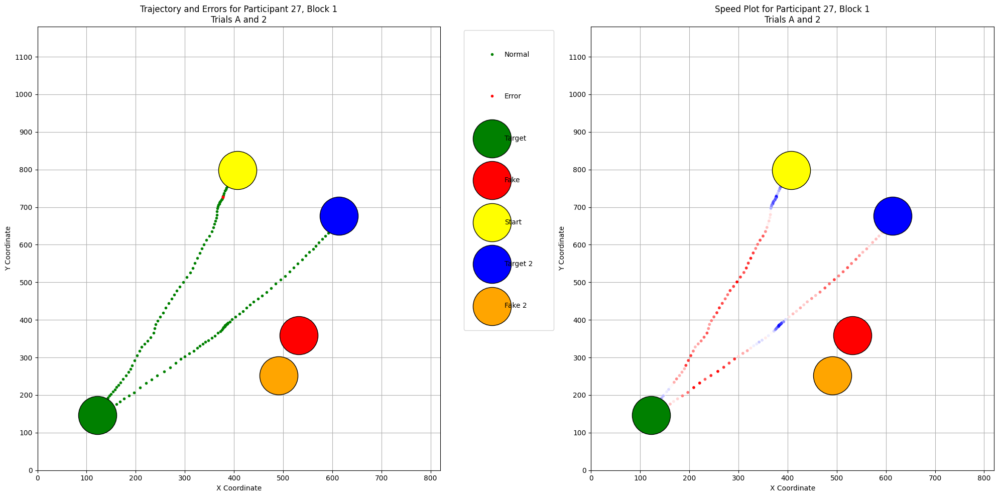

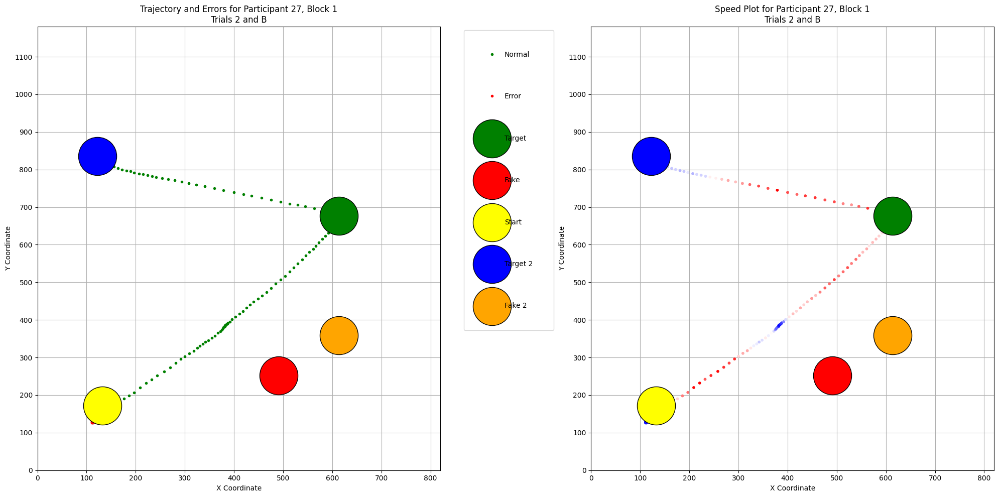

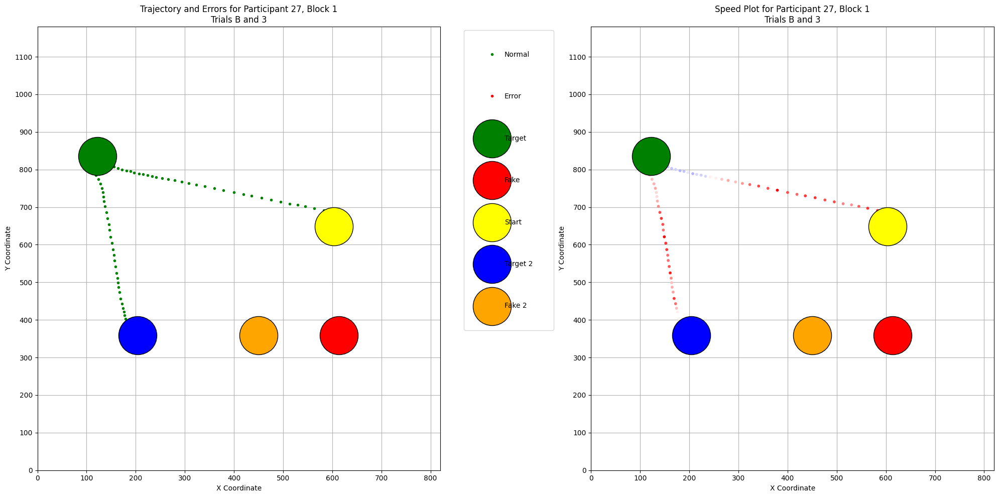

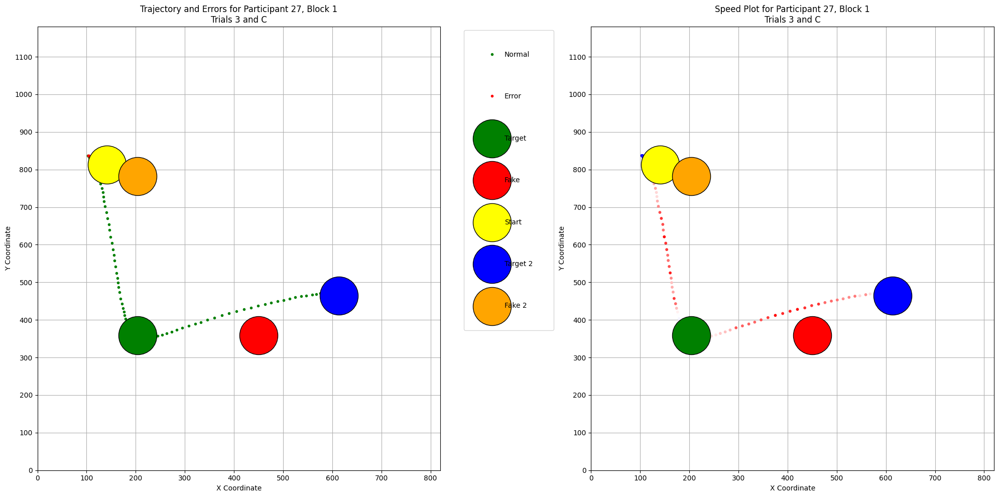

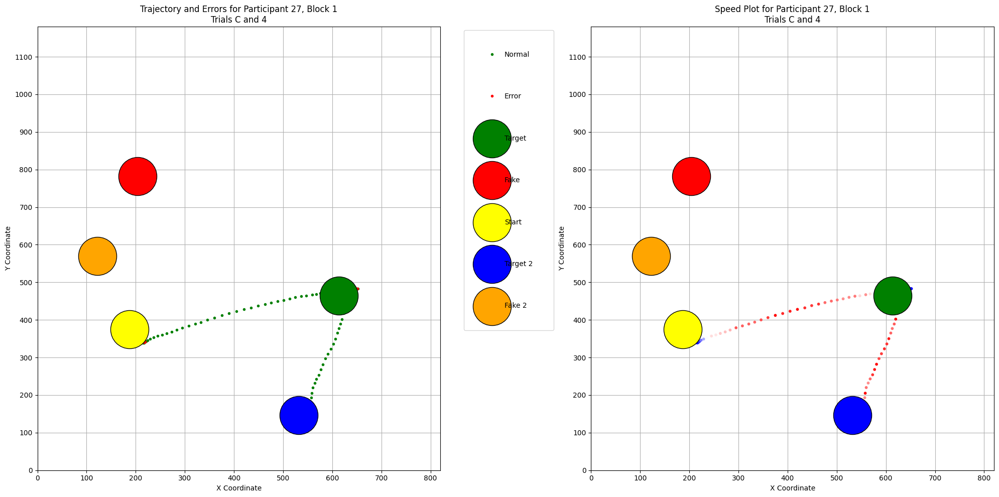

...

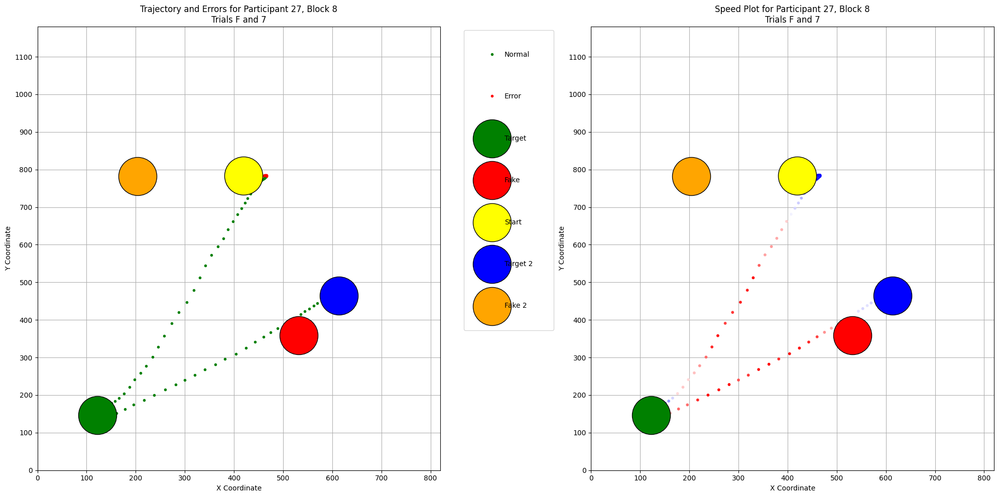

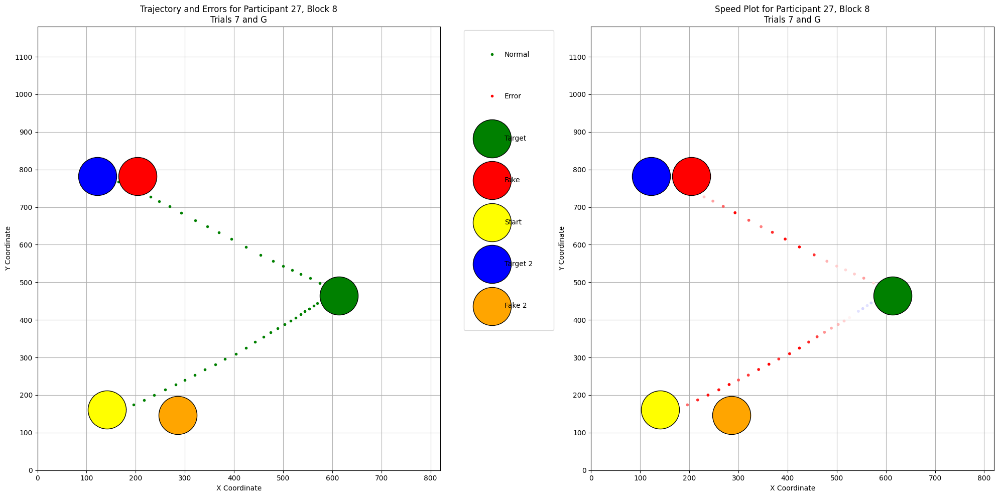

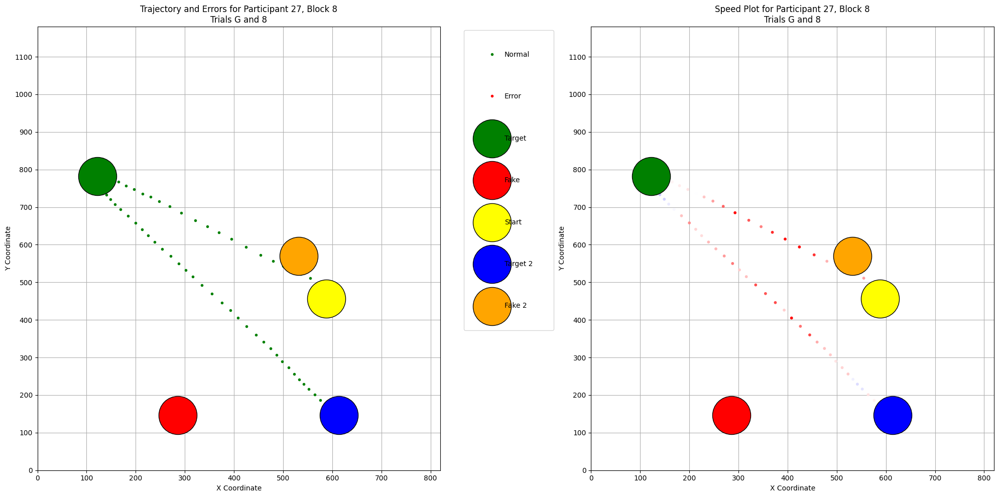

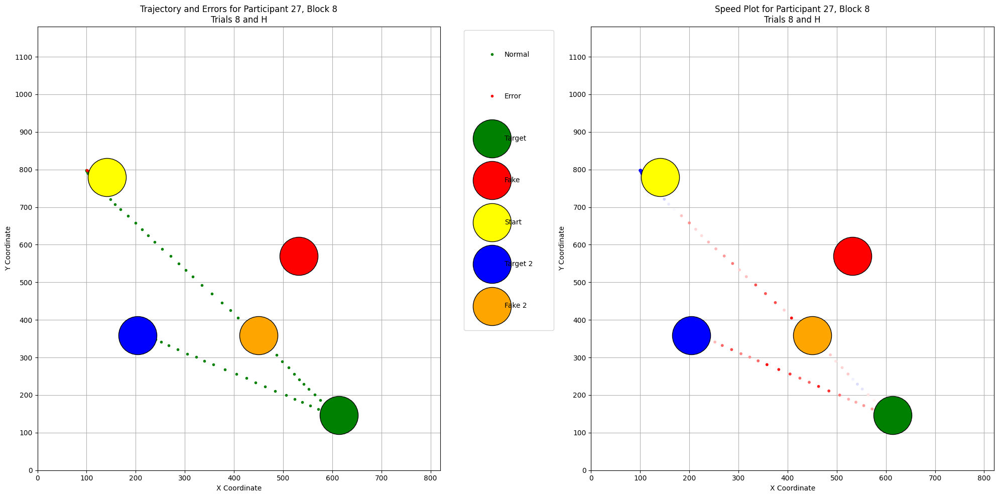

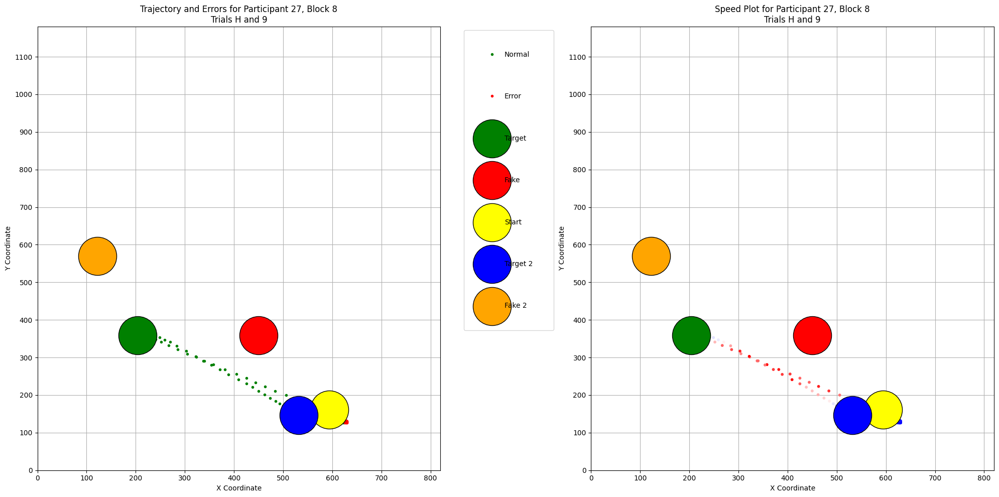

In [ ]:
if not os.path.exists('/content/error_speed_combined_trials'):
    os.makedirs('/content/error_speed_combined_trials')

for file_name in os.listdir('/content/error_speed_combined_trials'):
    file_path = os.path.join('/content/error_speed_combined_trials', file_name)
    if os.path.isfile(file_path):
        os.remove(file_path)

for i in df['pid'].unique():
    for j in df['blockno'].unique():
        real_points = df['realpointid'].unique()
        for idx in range(len(real_points) - 1):
            trialname1 = real_points[idx]
            trialname2 = real_points[idx + 1]

            df_trial1 = df.loc[(df['pid'] == i) & (df['blockno'] == j) & (df['realpointid'] == trialname1)]
            df_trial2 = df.loc[(df['pid'] == i) & (df['blockno'] == j) & (df['realpointid'] == trialname2)]

            prev_real1 = [df_trial1['realpointx'].iloc[0] + radius, df_trial1['realpointy'].iloc[0] + radius]
            prev_real2 = [df_trial2['realpointx'].iloc[0] + radius, df_trial2['realpointy'].iloc[0] + radius]

            plot_combined_trial_speed(
                df_trial1['coordx'], df_trial1['coordy'], df_trial1['pausevalue'],
                df_trial1['err'], [df_trial1['realpointx'].iloc[0] + radius, df_trial1['realpointy'].iloc[0] + radius],
                [df_trial1['fakepointx'].iloc[0] + radius, df_trial1['fakepointy'].iloc[0] + radius],
                prev_real1, df_trial1['speed'],
                df_trial2['coordx'], df_trial2['coordy'], df_trial2['pausevalue'],
                df_trial2['err'], [df_trial2['realpointx'].iloc[0] + radius, df_trial2['realpointy'].iloc[0] + radius],
                [df_trial2['fakepointx'].iloc[0] + radius, df_trial2['fakepointy'].iloc[0] + radius],
                prev_real2, df_trial2['speed'],
                i, j, trialname1, trialname2
            )

image_folder = '/content/error_speed_combined_trials'
output_pdf_path = '/content/error_speed_combined_trials.pdf'

images_to_pdf(image_folder, output_pdf_path)

# Code to automate stuff

In [ ]:
df_details = pd.read_csv('details.csv')

# Speed Comparisions - Slips




In [ ]:
if not os.path.exists('/content/speed_comparisions'):
    os.makedirs('/content/speed_comparisions')

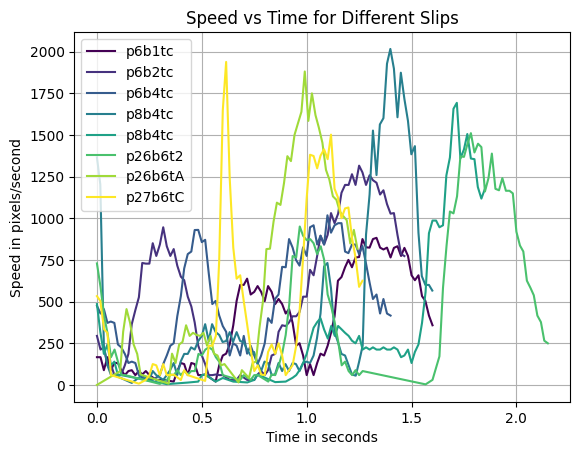

In [ ]:
speeds = []
times = []
df_slips = df_details.loc[(df_details['category'] == 'slip')]
df_slips = df_slips.reset_index(drop=True)
for i in range (0, len(df_slips)):
    df_trial = df.loc[(df['pid'] == df_slips.loc[i, 'pid']) & (df['blockno'] == df_slips.loc[i, 'blockno']) & (df['realpointid'] == df_slips.loc[i, 'real'])]
    time = df_trial['coordt'].values
    time = (time - time.min())/1000
    speed = df_trial['speed'].values
    speed = speed * 1000

    # Divide into segments based on -1 in time
    segments = divide_segments(time, speed)
    speeds.append(speed)
    times.append(time)

num_plots = len(times)


colors = plt.cm.viridis(np.linspace(0, 1, num_plots))

for idx, (time, speed) in enumerate(zip(times, speeds)):
    target = [word[-1] for word in df_slips["real"].iloc[idx]]
    label = f'p{df_slips["pid"].iloc[idx]}b{df_slips["blockno"].iloc[idx]}t{target[0]}'
    plt.plot(time, speed, marker='', linestyle='-', color=colors[idx], label=label)

# Adding labels and title
plt.xlabel('Time in seconds')
plt.ylabel('Speed in pixels/second')
plt.title(f'Speed vs Time for Different Slips')

# Adding grid and legend
plt.grid(True)
plt.legend()

# Save plot to file
filename = f'speed_time_slips.png'
filepath = os.path.join("/content/speed_comparisions", filename)
plt.savefig(filepath)
plt.show()

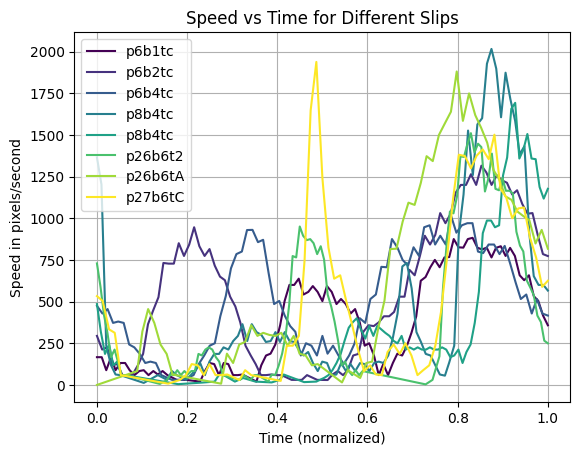

In [ ]:
speeds = []
times = []
df_slips = df_details.loc[(df_details['category'] == 'slip')]
df_slips = df_slips.reset_index(drop=True)
for i in range (0, len(df_slips)):
    df_trial = df.loc[(df['pid'] == df_slips.loc[i, 'pid']) & (df['blockno'] == df_slips.loc[i, 'blockno']) & (df['realpointid'] == df_slips.loc[i, 'real'])]
    time = df_trial['coordt'].values
    time = (time - time.min())/1000
    time = time / time.max()
    speed = df_trial['speed'].values
    speed = speed * 1000

    # Divide into segments based on -1 in time
    segments = divide_segments(time, speed)
    speeds.append(speed)
    times.append(time)

num_plots = len(times)


colors = plt.cm.viridis(np.linspace(0, 1, num_plots))

for idx, (time, speed) in enumerate(zip(times, speeds)):
    target = [word[-1] for word in df_slips["real"].iloc[idx]]
    label = f'p{df_slips["pid"].iloc[idx]}b{df_slips["blockno"].iloc[idx]}t{target[0]}'
    plt.plot(time, speed, marker='', linestyle='-', color=colors[idx], label=label)

# Adding labels and title
plt.xlabel('Time (normalized)')
plt.ylabel('Speed in pixels/second')
plt.title(f'Speed vs Time for Different Slips')

# Adding grid and legend
plt.grid(True)
plt.legend()

# Save plot to file
filename = f'speed_time_slips_normalized.png'
filepath = os.path.join("/content/speed_comparisions", filename)
plt.savefig(filepath)
plt.show()

# Speed Comparisions - Mistake

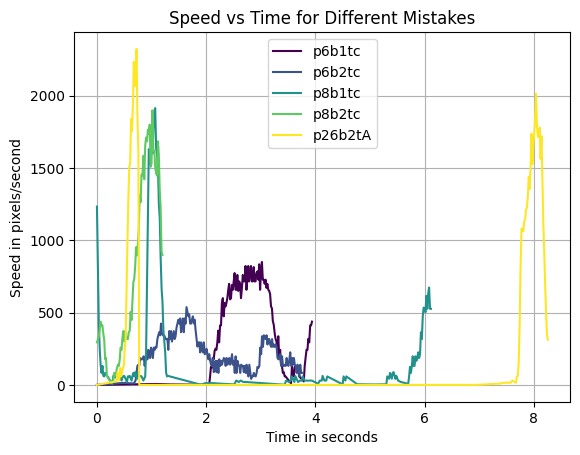

In [ ]:
speeds = []
times = []
df_mistake = df_details.loc[(df_details['category'] == 'mistake')]
df_mistake = df_mistake.reset_index(drop=True)
for i in range (0, len(df_mistake)):
    df_trial = df.loc[(df['pid'] == df_mistake.loc[i, 'pid']) & (df['blockno'] == df_mistake.loc[i, 'blockno']) & (df['realpointid'] == df_mistake.loc[i, 'real'])]
    time = df_trial['coordt'].values
    speed = df_trial['speed'].values
    speed = speed * 1000

    # Divide into segments based on -1 in time
    segments = divide_segments(time, speed)
    speeds.append(segments[0][1])
    times.append(segments[0][0])

num_plots = len(times)

for j in range(0, len(times)):
  times[j] = (times[j] - min(times[j]))/1000

colors = plt.cm.viridis(np.linspace(0, 1, num_plots))

for idx, (time, speed) in enumerate(zip(times, speeds)):
    target = [word[-1] for word in df_mistake["real"].iloc[idx]]
    label = f'p{df_mistake["pid"].iloc[idx]}b{df_mistake["blockno"].iloc[idx]}t{target[0]}'
    plt.plot(time, speed, marker='', linestyle='-', color=colors[idx], label=label)

# Adding labels and title
plt.xlabel('Time in seconds')
plt.ylabel('Speed in pixels/second')
plt.title(f'Speed vs Time for Different Mistakes')

# Adding grid and legend
plt.grid(True)
plt.legend()

# Save plot to file
filename = f'speed_time_mistakes.png'
filepath = os.path.join("/content/speed_comparisions", filename)
plt.savefig(filepath)
plt.show()

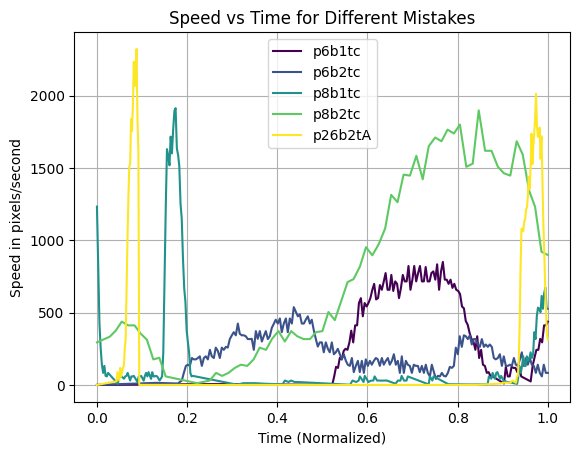

In [ ]:
speeds = []
times = []
df_mistake = df_details.loc[(df_details['category'] == 'mistake')]
df_mistake = df_mistake.reset_index(drop=True)
for i in range (0, len(df_mistake)):
    df_trial = df.loc[(df['pid'] == df_mistake.loc[i, 'pid']) & (df['blockno'] == df_mistake.loc[i, 'blockno']) & (df['realpointid'] == df_mistake.loc[i, 'real'])]
    time = df_trial['coordt'].values
    speed = df_trial['speed'].values
    speed = speed * 1000

    # Divide into segments based on -1 in time
    segments = divide_segments(time, speed)
    speeds.append(segments[0][1])
    times.append(segments[0][0])

num_plots = len(times)

for j in range(0, len(times)):
  times[j] = (times[j] - min(times[j]))/1000
  times[j] = times[j]/max(times[j])

colors = plt.cm.viridis(np.linspace(0, 1, num_plots))

for idx, (time, speed) in enumerate(zip(times, speeds)):
    target = [word[-1] for word in df_mistake["real"].iloc[idx]]
    label = f'p{df_mistake["pid"].iloc[idx]}b{df_mistake["blockno"].iloc[idx]}t{target[0]}'
    plt.plot(time, speed, marker='', linestyle='-', color=colors[idx], label=label)

# Adding labels and title
plt.xlabel('Time (Normalized)')
plt.ylabel('Speed in pixels/second')
plt.title(f'Speed vs Time for Different Mistakes')

# Adding grid and legend
plt.grid(True)
plt.legend()

# Save plot to file
filename = f'speed_time_mistakes_normalized.png'
filepath = os.path.join("/content/speed_comparisions", filename)
plt.savefig(filepath)
plt.show()

In [ ]:
image_folder = '/content/speed_comparisions'
output_pdf_path = '/content/speed_comparisions.pdf'

images_to_pdf(image_folder, output_pdf_path)

# Confidence

In [ ]:
max_speeds = []
max_speeds_after = []
conf = {}
names = []
time_difference = {}
time_difference_after = {}

df_slips = df_details.loc[(df_details['category'] == 'slip')]
df_slips = df_slips.reset_index(drop=True)

for i in range (0, len(df_slips)):
    df_trial = df.loc[(df['pid'] == df_slips.loc[i, 'pid']) & (df['blockno'] == df_slips.loc[i, 'blockno']) & (df['realpointid'] == df_slips.loc[i, 'real'])]
    time = df_trial['coordt'].values
    time = time - time.min()
    speed = df_trial['speed'].values
    err = df_trial['err'].values

    segments = confidence_split(time, speed, err)


    speed_time_1 = max_min_speed_time(segments[0][0], segments[0][1]) #max speed, max speed time, min speed, min speed time
    speed_time_2 = max_min_speed_time(segments[1][0], segments[1][1])
    conf_gain = (speed_time_2[0] - speed_time_1[0])*1000
    time_diff = (speed_time_2[3] - speed_time_1[1])/1000
    time_diff_after = (speed_time_2[1] - speed_time_1[1])/1000

    target = [word[-1] for word in df_slips["real"].iloc[i]]


    label = f'p{df_slips["pid"].iloc[i]}b{df_slips["blockno"].iloc[i]}t{target[-1]}'
    names.append(df_slips["pid"].iloc[i])
    conf[label] = conf_gain
    time_difference[label] = abs(time_diff)
    time_difference_after[label] = time_diff_after
    max_speeds.append(speed_time_1[0]*1000)
    max_speeds_after.append(speed_time_2[0]*1000)

In [ ]:
df_slips = df_details.loc[(df_details['category'] == 'slip')]
df_slips = df_slips.reset_index(drop=True)

slip_count = {}

for i in df_slips['pid'].unique():
  df_block = df_slips.loc[(df_slips['pid'] == i) & (df_slips['category'] == 'slip')]
  slip_count[i] = len(df_block)

## Together

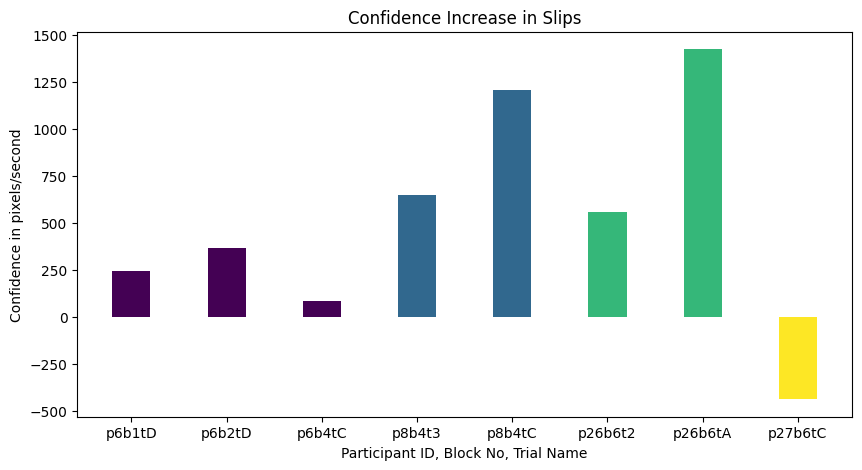

In [ ]:
label = list(conf.keys())

confidence = list(conf.values())

fig = plt.figure(figsize = (10, 5))

colors = plt.cm.viridis(np.linspace(0, 1, len(slip_count)))

for idx, (n, c) in enumerate(zip(names, confidence)):
    plt.bar(label[idx], confidence[idx], color = colors[list(slip_count.keys()).index(n)], width = 0.4)

plt.xlabel("Participant ID, Block No, Trial Name")
plt.ylabel("Confidence in pixels/second")
plt.title("Confidence Increase in Slips")
plt.show()

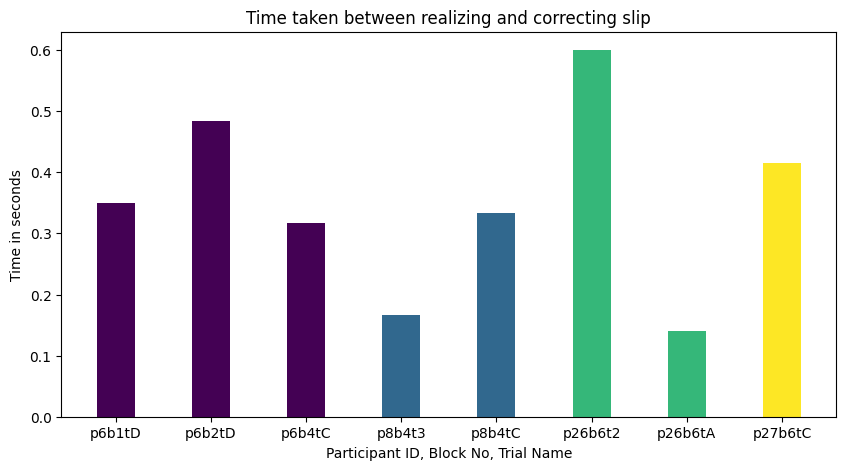

In [ ]:
label = list(time_difference.keys())

timediff = list(time_difference.values())

fig = plt.figure(figsize = (10, 5))

colors = plt.cm.viridis(np.linspace(0, 1, len(slip_count)))

for idx, (n, c) in enumerate(zip(names, timediff)):
    plt.bar(label[idx], timediff[idx], color = colors[list(slip_count.keys()).index(n)], width = 0.4)

plt.xlabel("Participant ID, Block No, Trial Name")
plt.ylabel("Time in seconds")
plt.title("Time taken between realizing and correcting slip")
plt.show()

## scatter plot for both

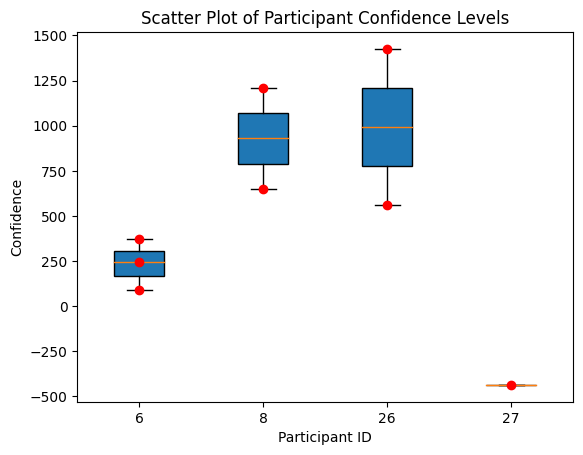

In [ ]:
name = [str(i) for i in names]
n = list(slip_count.keys())
confidence = list(conf.values())
pos = list(range(0, len(list(slip_count.keys()))))

total_slips = 0
p_conf = []

for i in slip_count:
  p_conf.append(confidence[total_slips:total_slips + slip_count[i]])
  total_slips = total_slips + slip_count[i]


plt.scatter(name, confidence, color='red')
plt.boxplot(p_conf, labels = n, positions = pos, widths=0.4, patch_artist=True, zorder=0)


# Add labels and title
plt.xlabel('Participant ID')
plt.ylabel('Confidence')
plt.title('Scatter Plot of Participant Confidence Levels')

# Show the plot
plt.show()

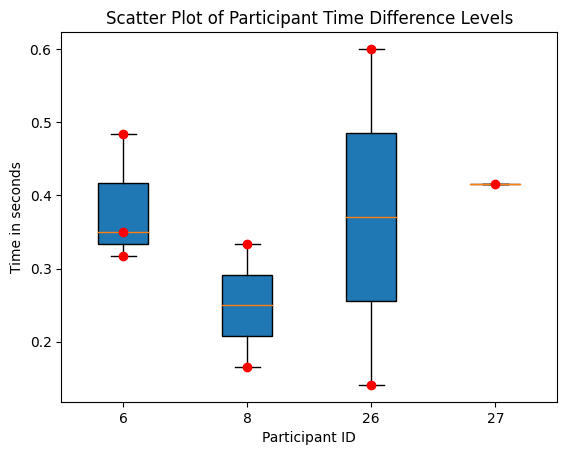

In [ ]:
name = [str(i) for i in names]
n = list(slip_count.keys())
timediff = list(time_difference.values())
pos = list(range(0, len(list(slip_count.keys()))))

total_slips = 0
p_tdiff = []

for i in slip_count:
  p_tdiff.append(timediff[total_slips:total_slips + slip_count[i]])
  total_slips = total_slips + slip_count[i]


plt.scatter(name, timediff, color='red')
plt.boxplot(p_tdiff, labels = n, positions = pos, widths=0.4, patch_artist=True, zorder=0)


# Add labels and title
plt.xlabel('Participant ID')
plt.ylabel('Time in seconds')
plt.title('Scatter Plot of Participant Time Difference Levels')

# Show the plot
plt.show()

## max speed for different categories

In [ ]:
max_correct = {x: 0 for x in df['pid'].unique()}
for i in df['pid'].unique():
    df_pid = df.loc[(df['pid'] == i)]
    for j in df_pid['blockno'].unique():
        df_block = df.loc[(df['pid'] == i) & (df['blockno'] == j)]
        for k in df_block['realpointid'].unique():
          if((df_details['pid'] == i) & (df_details['blockno'] == j) & (df_details['real'] == k)).any():
            continue
          else:
            df_trial = df.loc[(df['pid'] == i) & (df['blockno'] == j) & (df['realpointid'] == k)]
            speed = df_trial['speed'].values * 1000
            time = df_trial['coordt'].values
            time = time - time.min()
            time = time/1000
            speed_time = max_min_speed_time(time.tolist(), speed.tolist())
            if speed_time[0] > max_correct[i]:
              max_correct[i] = speed_time[0]

In [ ]:
max_slips_before = {x: 0 for x in df['pid'].unique()}
max_slips_after  = {x: 0 for x in df['pid'].unique()}

df_slips = df_details.loc[(df_details['category'] == 'slip')]
df_slips = df_slips.reset_index(drop=True)

for i in range (0, len(df_slips)):
    df_trial = df.loc[(df['pid'] == df_slips.loc[i, 'pid']) & (df['blockno'] == df_slips.loc[i, 'blockno']) & (df['realpointid'] == df_slips.loc[i, 'real'])]
    time = df_trial['coordt'].values
    time = time - time.min()
    time = time/1000
    speed = df_trial['speed'].values * 1000
    err = df_trial['err'].values

    segments = confidence_split(time, speed, err)
    speed_time_1 = max_min_speed_time(segments[0][0], segments[0][1]) #max speed, max speed time, min speed, min speed time
    speed_time_2 = max_min_speed_time(segments[1][0], segments[1][1])

    if speed_time_1[0] > max_slips_before[df_slips.loc[i, 'pid']]:
      max_slips_before[df_slips.loc[i, 'pid']] = speed_time_1[0]

    if speed_time_2[0] > max_slips_after[df_slips.loc[i, 'pid']]:
      max_slips_after[df_slips.loc[i, 'pid']] = speed_time_2[0]

In [ ]:
max_mistake = {x: 0 for x in df['pid'].unique()}

df_mistake = df_details.loc[(df_details['category'] == 'mistake')]
df_mistake = df_mistake.reset_index(drop=True)

for i in range (0, len(df_mistake)):
    df_trial = df.loc[(df['pid'] == df_mistake.loc[i, 'pid']) & (df['blockno'] == df_mistake.loc[i, 'blockno']) & (df['realpointid'] == df_mistake.loc[i, 'real'])]
    time = df_trial['coordt'].values
    time = time - time.min()
    time = time/1000
    speed = df_trial['speed'].values * 1000
    err = df_trial['err'].values

    div = divide_segments(time, speed)
    speed_time = max_min_speed_time(div[0][0], div[0][1])
    if speed_time[0] > max_mistake[df_mistake.loc[i, 'pid']]:
      max_mistake[df_mistake.loc[i, 'pid']] = speed_time[0]

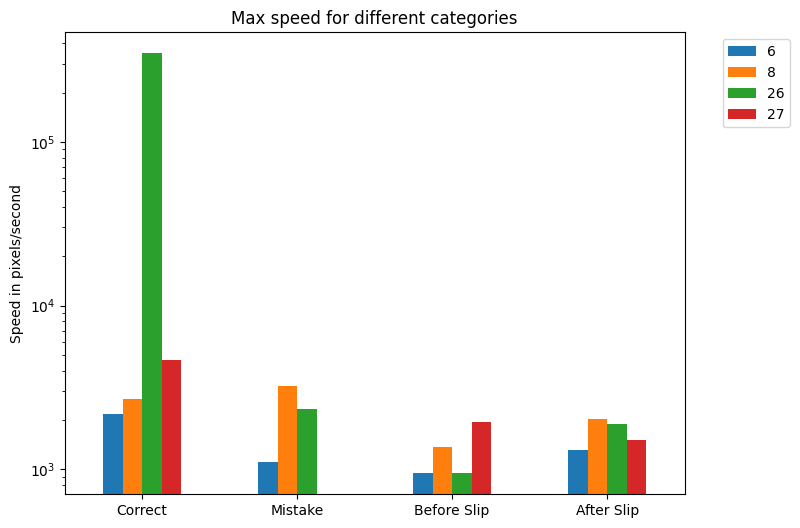

In [ ]:
df_combo = pd.DataFrame(columns=['pid', 'Correct', 'Mistake', 'Before Slip', 'After Slip'])
max_speeds_overall = {}
for i in max_correct.keys():
  max_speed = [i, max_correct[i], max_mistake[i], max_slips_before[i], max_slips_after[i]]
  df_combo.loc[len(df_combo.index)] = max_speed
  max_speeds_overall[i] = max_speed

df_combo = df_combo.T
df_combo.rename(columns=df.iloc[0], inplace = True)
df_combo.drop(df_combo.index[0], inplace=True)
df_combo.columns = max_correct.keys()


ax = df_combo.plot(kind='bar', logy=True, figsize=(8, 6), rot=0, ylabel='Speed in pixels/second', title='Max speed for different categories')
ax.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
p = plt.show()

In [ ]:
df_combo

,6,8,26,27
Correct,2191.068518,2687.500000,347604.660498,4620.352395
Mistake,1105.193778,3226.477375,2322.613022,0.000000
Before Slip,945.796622,1364.401589,950.323201,1937.500000
After Slip,1315.334104,2015.564437,1880.201120,1501.301519


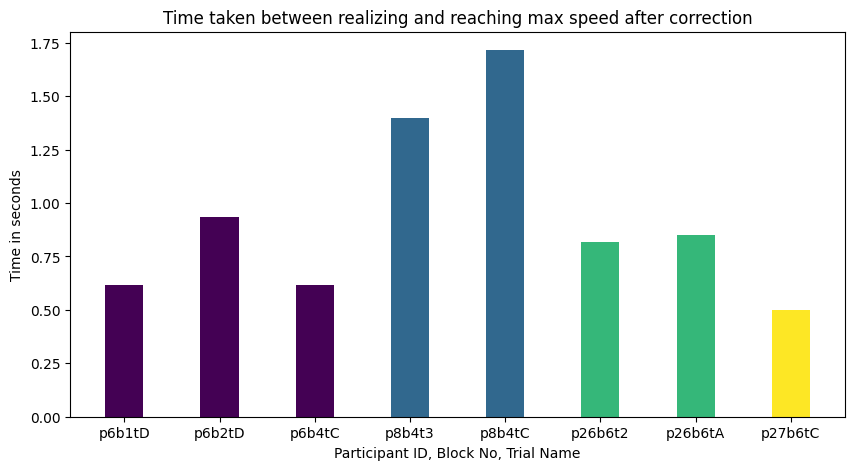

In [ ]:
label = list(time_difference_after.keys())
timediff = list(time_difference_after.values())

fig = plt.figure(figsize = (10, 5))

colors = plt.cm.viridis(np.linspace(0, 1, len(slip_count)))

for idx, (n, c) in enumerate(zip(names, timediff)):
    plt.bar(label[idx], timediff[idx], color = colors[list(slip_count.keys()).index(n)], width = 0.4)

plt.xlabel("Participant ID, Block No, Trial Name")
plt.ylabel("Time in seconds")
plt.title("Time taken between realizing and reaching max speed after correction")
plt.show()

In [ ]:
name = list(conf.keys())
confidence = list(conf.values())
confidence = np.array(confidence)

max_speeds_after_temp = np.array(max_speeds_after)
max_speeds_before_temp = np.array(max_speeds)


total_slips = 0
p_conf = []
max_after = []
max_before = []

for i in slip_count:
  p_conf.extend(confidence[total_slips:total_slips + slip_count[i]]/max(max_speeds_overall[i]))
  max_after.extend(max_speeds_after_temp[total_slips:total_slips + slip_count[i]]/max(max_speeds_overall[i]))
  max_before.extend(max_speeds_before_temp[total_slips:total_slips + slip_count[i]]/max(max_speeds_overall[i]))
  total_slips = total_slips + slip_count[i]

p_conf = [round(elem, 4) for elem in p_conf]
max_before = [round(elem, 4) for elem in max_before]
max_after = [round(elem, 4) for elem in max_after]


conf_df = {
     'confidence': p_conf,
     'max_before': max_before,
     'max_after' : max_after
    }


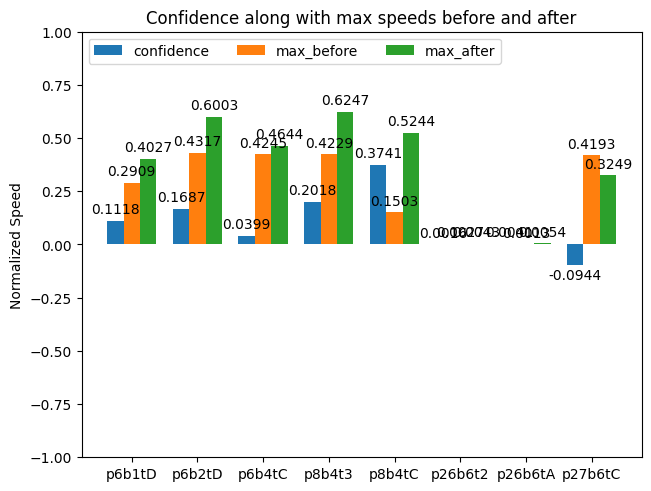

In [ ]:
x = np.arange(len(name))  # the label locations
width = 0.25  # the width of the bars
multiplier = 0

fig, ax = plt.subplots(layout='constrained')

for attribute, measurement in conf_df.items():
    offset = width * multiplier
    rects = ax.bar(x + offset, measurement, width, label=attribute)
    ax.bar_label(rects, padding=3)
    multiplier += 1

# Add some text for labels, title and custom x-axis tick labels, etc.
ax.set_ylabel('Normalized Speed')
ax.set_title('Confidence along with max speeds before and after')
ax.set_xticks(x + width, name)
ax.legend(loc='upper left', ncols=3)
ax.set_ylim(-1, 1)

plt.show()

# PCA, PCoA and t-sne

In [ ]:
mean_df

,pid,blockno,numpause,maxpause,minpause,avgpause,error_rate,numerrorcorr,maxspeed,minspeed,avgspeed,moca
0,6.0,1.0,15.0,1073.0,100.0,365.600000,0.376168,36.0,1.729483,0.001397,0.412125,28.0
1,6.0,2.0,12.0,491.0,100.0,209.833333,0.346591,23.0,1.839242,0.002309,0.437765,26.0
2,6.0,3.0,7.0,394.0,100.0,163.571429,0.192771,27.0,2.174066,0.005076,0.603165,30.0
3,6.0,4.0,9.0,300.0,100.0,173.555556,0.244482,21.0,2.191069,0.003333,0.681980,30.0
4,8.0,1.0,29.0,824738.0,117.0,28851.448276,0.419847,35.0,2.412482,0.000320,0.593693,27.0
5,8.0,2.0,8.0,606.0,100.0,286.625000,0.231975,30.0,3.226477,0.002732,0.703586,27.0
6,8.0,3.0,9.0,343.0,133.0,231.000000,0.209709,52.0,2.414632,0.003322,0.589132,30.0
7,8.0,4.0,8.0,284.0,100.0,157.750000,0.345092,47.0,2.687500,0.003521,0.560678,28.0
8,26.0,1.0,23.0,538.0,100.0,206.739130,0.205446,43.0,3.087272,0.002070,0.727253,26.0
9,26.0,2.0,23.0,444.0,100.0,200.260870,0.242131,42.0,2.752839,0.002732,0.731041,29.0


In [ ]:
mean_df.loc[mean_df.pid == 6.0, 'moca'] = 27
mean_df.loc[mean_df.pid == 8.0, 'moca'] = 26
mean_df.loc[mean_df.pid == 26.0, 'moca'] = 29
mean_df.loc[mean_df.pid == 27.0, 'moca'] = 29

In [ ]:
mean_df['maxspeed'] = mean_df['maxspeed']*1000
mean_df['minspeed'] = mean_df['minspeed']*1000
mean_df['avgspeed'] = mean_df['avgspeed']*1000


mean_df['avgpause'] = mean_df['avgpause']/1000
mean_df['minpause'] = mean_df['minpause']/1000
mean_df['maxpause'] = mean_df['maxpause']/1000

In [ ]:
mean_df = mean_df.drop('blockno', axis=1)

In [ ]:
mean_df

,pid,numpause,maxpause,minpause,avgpause,error_rate,numerrorcorr,maxspeed,minspeed,avgspeed,moca
0,6.0,15.0,1.073,0.100,0.365600,0.376168,36.0,1729.482903,1.396648,412.124834,27.0
1,6.0,12.0,0.491,0.100,0.209833,0.346591,23.0,1839.242371,2.309469,437.764942,27.0
2,6.0,7.0,0.394,0.100,0.163571,0.192771,27.0,2174.065891,5.076142,603.164663,27.0
3,6.0,9.0,0.300,0.100,0.173556,0.244482,21.0,2191.068518,3.333333,681.979688,27.0
4,8.0,29.0,824.738,0.117,28.851448,0.419847,35.0,2412.481959,0.319782,593.693239,26.0
5,8.0,8.0,0.606,0.100,0.286625,0.231975,30.0,3226.477375,2.732240,703.585846,26.0
6,8.0,9.0,0.343,0.133,0.231000,0.209709,52.0,2414.632441,3.322259,589.132199,26.0
7,8.0,8.0,0.284,0.100,0.157750,0.345092,47.0,2687.500000,3.521127,560.678126,26.0
8,26.0,23.0,0.538,0.100,0.206739,0.205446,43.0,3087.272259,2.070393,727.253189,29.0
9,26.0,23.0,0.444,0.100,0.200261,0.242131,42.0,2752.839443,2.732240,731.041450,29.0


In [ ]:
mean_df = mean_df.groupby('pid').mean().reset_index()

In [ ]:
total_slips = 0
avg_conf = []

for i in slip_count:
  avg_conf.append(sum(confidence[total_slips:total_slips + slip_count[i]])/slip_count[i])
  total_slips = total_slips + slip_count[i]

In [ ]:
mean_df['avgconf'] = avg_conf

In [ ]:
mean_df

,pid,numpause,maxpause,minpause,avgpause,error_rate,numerrorcorr,maxspeed,minspeed,avgspeed,moca,avgconf
0,6.0,10.75,0.564500,0.100000,0.228140,0.290003,26.75,1983.464921,3.028898,533.758532,27.0,233.952536
1,8.0,13.50,206.492750,0.112500,7.381706,0.301656,41.00,2685.272944,2.473852,611.772353,26.0,929.107447
2,26.0,18.75,0.522375,0.100125,0.202425,0.218643,45.25,45794.325824,2.989465,836.564053,29.0,992.625898
3,27.0,23.00,0.500375,0.100000,0.197335,0.225474,51.75,3176.195913,2.273638,600.496734,29.0,-436.198481


In [ ]:
mean_df = mean_df.drop('maxspeed', axis=1)

In [ ]:
mean_df = mean_df.drop('minspeed', axis=1)

In [ ]:
mean_df['numerrorcorr'] = list(slip_count.values())

In [ ]:
mean_df['maxcorrect'] = max_correct.values()
mean_df['maxwrong'] = max_mistake.values()
mean_df['maxbeforeslip'] = max_slips_before.values()
mean_df['maxafterslip'] = max_slips_after.values()

In [ ]:
mean_df

,pid,numpause,maxpause,minpause,avgpause,error_rate,numerrorcorr,avgspeed,moca,avgconf,maxcorrect,maxwrong,maxbeforeslip,maxafterslip
0,6.0,10.75,0.564500,0.100000,0.228140,0.290003,3,533.758532,27.0,233.952536,2191.068518,1105.193778,945.796622,1315.334104
1,8.0,13.50,206.492750,0.112500,7.381706,0.301656,2,611.772353,26.0,929.107447,2687.500000,3226.477375,1364.401589,2015.564437
2,26.0,18.75,0.522375,0.100125,0.202425,0.218643,2,836.564053,29.0,992.625898,347604.660498,2322.613022,950.323201,1880.201120
3,27.0,23.00,0.500375,0.100000,0.197335,0.225474,1,600.496734,29.0,-436.198481,4620.352395,0.000000,1937.500000,1501.301519


In [ ]:
# Example data (replace with your actual dataframe)
data = mean_df

# Drop 'pid' as it's an identifier, not relevant for the analysis
X = data.drop(columns=['pid'])

In [ ]:
from sklearn.preprocessing import StandardScaler

# Standardize the features
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)


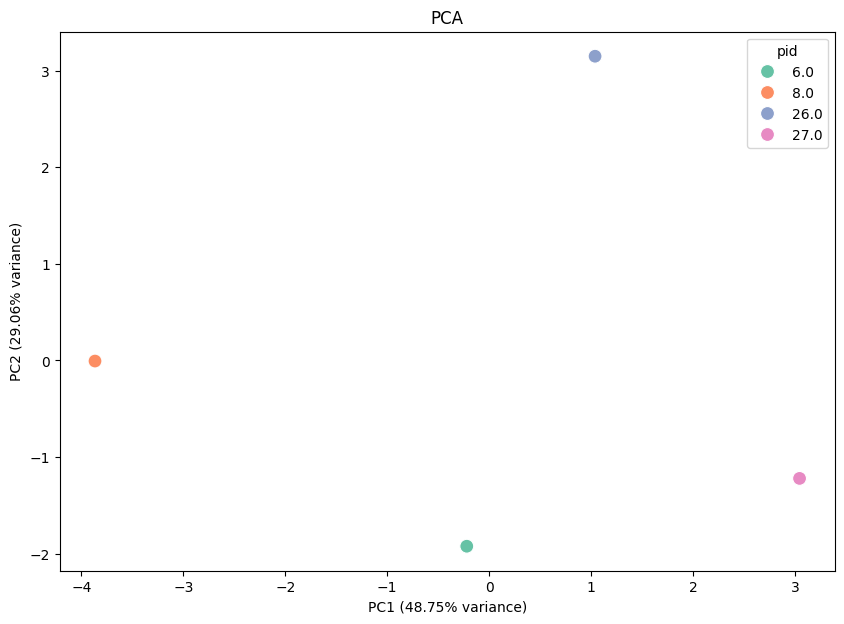

In [ ]:
from sklearn.decomposition import PCA
import matplotlib.pyplot as plt
import seaborn as sns

# Fit PCA
pca = PCA(n_components=2)
X_pca = pca.fit_transform(X_scaled)

# Explained variance ratio for each component
explained_variance = pca.explained_variance_ratio_ * 100

# Create a PCA dataframe for visualization
pca_df = pd.DataFrame(data=X_pca, columns=['PC1', 'PC2'])
pca_df['pid'] = data['pid']  # Add pid back for labeling

# Plot PCA with explained variance in axis labels
plt.figure(figsize=(10, 7))
sns.scatterplot(x='PC1', y='PC2', data=pca_df, hue='pid', palette='Set2', s=100)

# Add explained variance to the axis labels
plt.xlabel(f'PC1 ({explained_variance[0]:.2f}% variance)')
plt.ylabel(f'PC2 ({explained_variance[1]:.2f}% variance)')
plt.title('PCA')
plt.show()


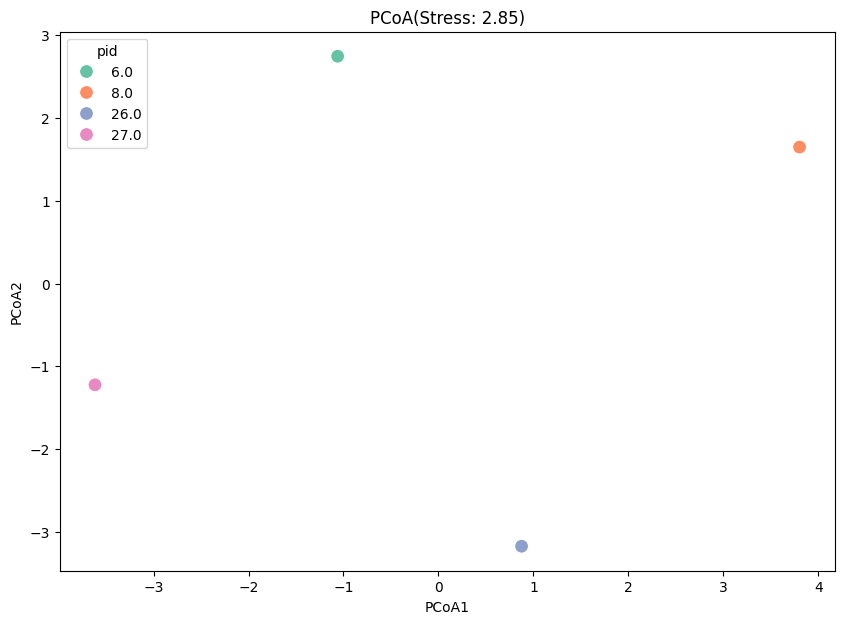

In [ ]:
from sklearn.metrics import pairwise_distances
from sklearn.manifold import MDS

# Compute a distance matrix (Euclidean distance)
dist_matrix = pairwise_distances(X_scaled)

# Use MDS for PCoA (metric multi-dimensional scaling)
mds = MDS(n_components=2, dissimilarity='precomputed', random_state=42)
X_pcoa = mds.fit_transform(dist_matrix)

# Stress value (indicates how well MDS preserved distances)
stress = mds.stress_

# Create a PCoA dataframe for visualization
pcoa_df = pd.DataFrame(data=X_pcoa, columns=['PCoA1', 'PCoA2'])
pcoa_df['pid'] = data['pid']

# Plot PCoA with stress in title
plt.figure(figsize=(10, 7))
sns.scatterplot(x='PCoA1', y='PCoA2', data=pcoa_df, hue='pid', palette='Set2', s=100)

# Add stress to the plot title
plt.title(f'PCoA(Stress: {stress:.2f})')
plt.xlabel('PCoA1')
plt.ylabel('PCoA2')
plt.show()


How to interpret stress values:
* < 0.05: Excellent representation.
* 0.05 - 0.1: Good representation.
* 0.1 - 0.2: Fair representation.
* \> 0.2: Poor representation

(higher stress means the embedding is not faithfully representing the original distances).

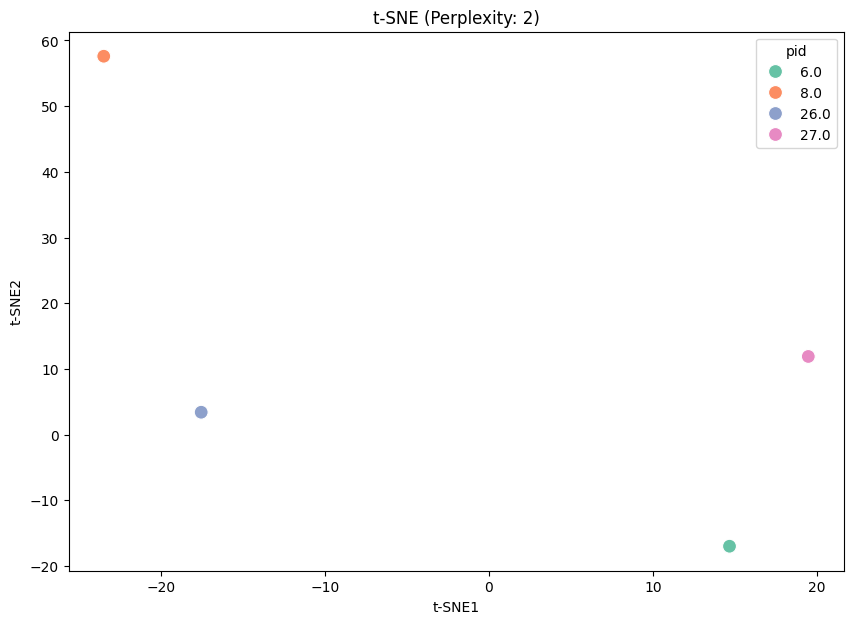

In [ ]:
from sklearn.manifold import TSNE

# Fit t-SNE
n_samples = mean_df.shape[0]

perplexity = min(2, n_samples - 1)  # Ensure perplexity is smaller than n_samples
tsne = TSNE(n_components=2, perplexity=perplexity, random_state=42)
X_tsne = tsne.fit_transform(X_scaled)

# Create a t-SNE dataframe for visualization
tsne_df = pd.DataFrame(data=X_tsne, columns=['t-SNE1', 't-SNE2'])
tsne_df['pid'] = data['pid']

# Plot t-SNE with perplexity in the title
plt.figure(figsize=(10, 7))
sns.scatterplot(x='t-SNE1', y='t-SNE2', data=tsne_df, hue='pid', palette='Set2', s=100)

# Add perplexity to the plot title
plt.title(f't-SNE (Perplexity: {perplexity})')
plt.xlabel('t-SNE1')
plt.ylabel('t-SNE2')
plt.show()


# Time Taken

In [ ]:
# Initialize an empty list to store the data
combo_data = []

# Loop through each participant (pid)
for i in df['pid'].unique():
    df_pid = df[df['pid'] == i]  # Filter by participant
    # Loop through each block for that participant
    for j in df_pid['blockno'].unique():
        df_block = df_pid[df_pid['blockno'] == j]  # Filter by block
        max_time = max(df_block['coordt']) / 1000  # Calculate max time in seconds
        combo_data.append([i, j, max_time])  # Append to list

# Convert the list into a DataFrame
df_combo = pd.DataFrame(combo_data, columns=['pid', 'blockno', 'time'])

df_combo = df_combo[df_combo.blockno != 1]


# Reshape the DataFrame to have 'blockno' as the index and 'pid' as the columns
df_pivot = df_combo.pivot(index='blockno', columns='pid', values='time')

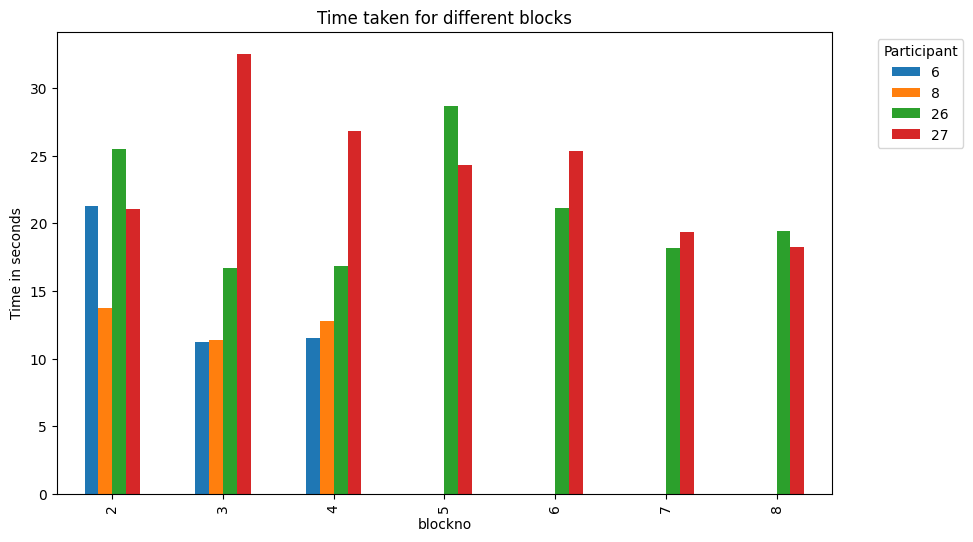

In [ ]:
# Plot the grouped bar chart
ax = df_pivot.plot(kind='bar', figsize=(10, 6), ylabel='Time in seconds', title='Time taken for different blocks')
ax.legend(title='Participant', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.show()